In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import pickle
import neurokit2 as nk
import datetime
from scipy import signal
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

# Functions

In [2]:
def GetEDAData(data):
    empatica_samp_time = 1/4
    label_samp_time = 1/700

    i = round(empatica_samp_time / label_samp_time)

    labels = data['label'][::i]
    eda = data['signal']['wrist']['EDA'][:len(labels)]
    time = np.arange(0, len(labels)) * empatica_samp_time * 1e03

    df = pd.DataFrame({"Labels":labels, "EDA":eda.flatten(), "Time":time}).reset_index(drop=True)
    stress = df[df['Labels'] == 2].reset_index(drop=True)
    meditation = df[df['Labels'] == 4].reset_index(drop=True)
    baseline = df[df['Labels'] == 1].reset_index(drop=True)

    return df, stress, baseline, meditation

In [3]:
def GetBVPData(data):
    empatica_samp_time = 1/64
    label_samp_time = 1/700

    i = round(empatica_samp_time / label_samp_time)

    labels = data['label'][::i]
    bvp = data['signal']['wrist']['BVP'][:len(labels)]
    time = np.arange(0, len(labels)) * empatica_samp_time * 1e03

    df = pd.DataFrame({"Labels":labels, "BVP":bvp.flatten(), "Time":time}).reset_index(drop=True)
    stress = df[df['Labels'] == 2].reset_index(drop=True)
    meditation = df[df['Labels'] == 4].reset_index(drop=True)
    baseline = df[df['Labels'] == 1].reset_index(drop=True)

    return df, stress, baseline, meditation

In [4]:
def AnalyzeHRV(bvp, timewidth=5):
    bvp['timestamp'] = pd.to_datetime(bvp['Time'] * 1e06)
    bvp.set_index('timestamp', inplace=True)
    minute_bins = bvp.resample(str(timewidth) + 'T')

    time_stats = pd.DataFrame([])
    freq_stats = pd.DataFrame([])
    label_array = []
    
    for minute, minute_data in minute_bins:

        try:
            _, peaks = nk.ppg_process(minute_data['BVP'], sampling_rate=64)
        except:
            peaks = []
        
        # Time Parameters
        try:              
            time_stats = pd.concat([time_stats, nk.hrv_time(peaks, sampling_rate=64)], axis=0, ignore_index=True)
        except:
            time_stats = pd.concat([time_stats, pd.DataFrame(np.zeros((1, len(time_stats.columns))), columns=time_stats.columns)], axis=0, ignore_index=True)                

        # Frequency Parameters
        try:
            freq_stats = pd.concat([freq_stats, nk.hrv_frequency(peaks, sampling_rate=64)], axis=0, ignore_index=True)
        except:
            freq_stats = pd.concat([freq_stats, pd.DataFrame(np.zeros((1, len(freq_stats.columns))), columns=freq_stats.columns)], axis=0, ignore_index=True)

        try:
            label_array.append(minute_data['Labels'].values[0])
        except:
            label_array.append(np.nan)
            

    label_array = pd.DataFrame({"labels":label_array})
    results = pd.concat([time_stats, freq_stats, label_array], axis=1)
    return results

In [5]:
def AnalyzeEDA(eda_data, timewidth):    
    # Median Filtering
    eda_data["EDA"] = signal.medfilt(eda_data["EDA"].values, kernel_size=7)
    
    # Resampling Data
    y = eda_data['EDA'].values
    yn = (y - y.mean()) / y.std()
    eda_resampled = signal.resample(yn, len(eda_data)*3)
    sampFreq = len(eda_resampled) / ((eda_data['Time'].iloc[-1] - eda_data['Time'].iloc[0]) * 1e-03)
    
    t_resampled = np.arange(eda_data['Time'].iloc[0], eda_data['Time'].iloc[-1], 1/sampFreq * 1e03)
    t_dt_resampled = pd.to_datetime(t_resampled * 1e06)

    signals, info = nk.eda_process(eda_resampled, sampling_rate=sampFreq)

    if len(signals) <= len(t_dt_resampled):
        signals['timestamp'] = t_dt_resampled[:len(signals)]
        signals['time'] = t_resampled[:len(signals)]

    elif len(signals) > len(t_dt_resampled):
        d = len(signals) - len(t_dt_resampled)
        signals = signals.iloc[:-d]
        signals['timestamp'] = t_dt_resampled[:len(signals)]
        signals['time'] = t_resampled[:len(signals)]

    signals.set_index('timestamp', inplace=True)
    minute_bins = signals.resample(str(timewidth) + 'T')
    
    mean_scr = []
    sd_scr = []
    n_scr = []
    mean_scl = []
    sd_scl = []
    slope_scl = []

    for _, minute_data in minute_bins:
 

        time_slice = minute_data

        scr = time_slice[time_slice['SCR_Peaks'] == 1]
        mean_scr.append(np.mean(scr['SCR_Amplitude']))
        sd_scr.append(np.std(scr['SCR_Amplitude']))
        n_scr.append(len(scr['SCR_Amplitude']))

        mean_scl.append(np.mean(time_slice["EDA_Tonic"]))
        sd_scl.append(np.std(time_slice["EDA_Tonic"]))


    results = pd.DataFrame({'Mean_SCR':mean_scr, 'STD_SCR':sd_scr,'N_SCR':n_scr, 'Mean_SCL':mean_scl, 'STD_SCL':sd_scl})
    results = results.fillna(0)
    return results

# Testing With 1 min

In [6]:
dir_path = "/home/prabhaka/Documents/HiWi/RP2_Files/Untitled Folder/WESAD/"

participants = os.listdir(dir_path)
timewidth = 5

participants_data = {}

for p in tqdm(participants):
    
    df = pd.DataFrame()
    
    file = open(dir_path + "/" + p + "/"+ p +".pkl",'rb')
    data = pickle.load(file, encoding='latin1')
    file.close()
    
    fd_h, stress_h, baseline_h, meditation_h = GetBVPData(data)
    fd_e, stress_e, baseline_e, meditation_e = GetEDAData(data)

    # Forming Baseline Data
    base_hrv = AnalyzeHRV(baseline_h, timewidth=timewidth)
    base_eda = AnalyzeEDA(baseline_e, timewidth=timewidth)
    base_stats = pd.concat([base_hrv, base_eda], axis=1).reset_index(drop=True)
    base_stats = pd.concat([base_stats, pd.DataFrame({'Stress':np.zeros(len(base_stats))})], axis=1).reset_index(drop=True)
    
    # Forming Stress Data
    stress_hrv = AnalyzeHRV(stress_h, timewidth=timewidth)
    stress_eda = AnalyzeEDA(stress_e, timewidth=timewidth)
    stress_stats = pd.concat([stress_hrv, stress_eda], axis=1).reset_index(drop=True)
    stress_stats = pd.concat([stress_stats, pd.DataFrame({'Stress':np.ones(len(stress_stats))})], axis=1).reset_index(drop=True)

    ih = np.where(np.diff(meditation_h['Time'].values) > np.mean(np.diff(meditation_h['Time'].values)))[0][0]    
    ie = np.where(np.diff(meditation_e['Time'].values) > np.mean(np.diff(meditation_e['Time'].values)))[0][0]
    
    med_h = meditation_h.iloc[0: ih + 1].reset_index(drop=True)
    med_e = meditation_e.iloc[0: ie + 1].reset_index(drop=True)
    med_hrv  = AnalyzeHRV(med_h, timewidth=timewidth)
    med_eda = AnalyzeEDA(med_e, timewidth=timewidth)
    med_stats_1 = pd.concat([med_hrv, med_eda], axis=1).reset_index(drop=True)
    med_stats_1 = pd.concat([med_stats_1, pd.DataFrame({'Stress':np.ones(len(med_stats_1))*-1})], axis=1).reset_index(drop=True)

    
    med_h = meditation_h.iloc[ih + 1:].reset_index(drop=True)
    med_e = meditation_e.iloc[ie + 1:].reset_index(drop=True)
    med_hrv  = AnalyzeHRV(med_h, timewidth=timewidth)
    med_eda = AnalyzeEDA(med_e, timewidth=timewidth)
    med_stats_2 = pd.concat([med_hrv, med_eda], axis=1).reset_index(drop=True)
    med_stats_2 = pd.concat([med_stats_2, pd.DataFrame({'Stress':np.ones(len(med_stats_1))*-1})], axis=1).reset_index(drop=True)

    df = pd.concat([df, base_stats, stress_stats, med_stats_1, med_stats_2]).reset_index(drop=True)
    df = df.drop(columns=['HRV_SDANN2', 'HRV_SDNNI2', 'HRV_SDANN5', 'HRV_SDNNI5', 'HRV_ULF'])

    full_hrv = AnalyzeHRV(fd_h, timewidth=timewidth)
    full_eda = AnalyzeEDA(fd_e, timewidth=timewidth)
    full_stats = pd.concat([full_hrv, full_eda], axis=1).reset_index(drop=True)
    
    participants_data[p] = {}
    participants_data[p]["processed_data"] = df
    participants_data[p]["full_data"] = full_stats

100%|███████████████████████████████████████████| 15/15 [00:54<00:00,  3.61s/it]


# Exploratory Analysis For Feature Extraction

In [7]:
drop_cols = []
corr_cols = ["HRV_SDSD", "HRV_SDNN", "HRV_CVNN", "HRV_CVSD", "HRV_Prc20NN", "HRV_MadNN", "HRV_VHF", "HRV_TP", "HRV_Prc80NN", "HRV_MCVNN", "HRV_pNN50", "HRV_HF", "HRV_LF", "HRV_SDRMSSD", "HRV_VLF"]

filtered_df = {}

for participant in participants_data.keys():
    d = participants_data[participant]['processed_data'].fillna(0)
    for cols in d.columns:
        if (d[cols] == 0).all():
            drop_cols.append(cols)
        if cols == "Stress":
            drop_cols.append(cols)
        if cols in corr_cols:
            drop_cols.append(cols)
    d = d.drop(columns=drop_cols)
    d = d[((d == 0).sum(axis=1) / d.shape[1]) < 0.5] 
    filtered_df[participant] = d

In [8]:
def clean_data(d):
    drop_cols = []
    corr_cols = ["HRV_SDSD", "HRV_SDNN", "HRV_CVNN", "HRV_CVSD", "HRV_Prc20NN", "HRV_MadNN", "HRV_VHF", "HRV_TP", "HRV_Prc80NN", "HRV_MCVNN", "HRV_pNN50", "HRV_HF", "HRV_LF", "HRV_SDRMSSD", "HRV_VLF"]
    d = d.fillna(0)
    for cols in d.columns:
        if (d[cols] == 0).all():
            drop_cols.append(cols)
        if cols == "Stress":
            drop_cols.append(cols)
        if cols in corr_cols:
            drop_cols.append(cols)
    d = d.drop(columns=drop_cols)
    d = d[((d == 0).sum(axis=1) / d.shape[1]) < 0.5] 
    return d

<AxesSubplot:>

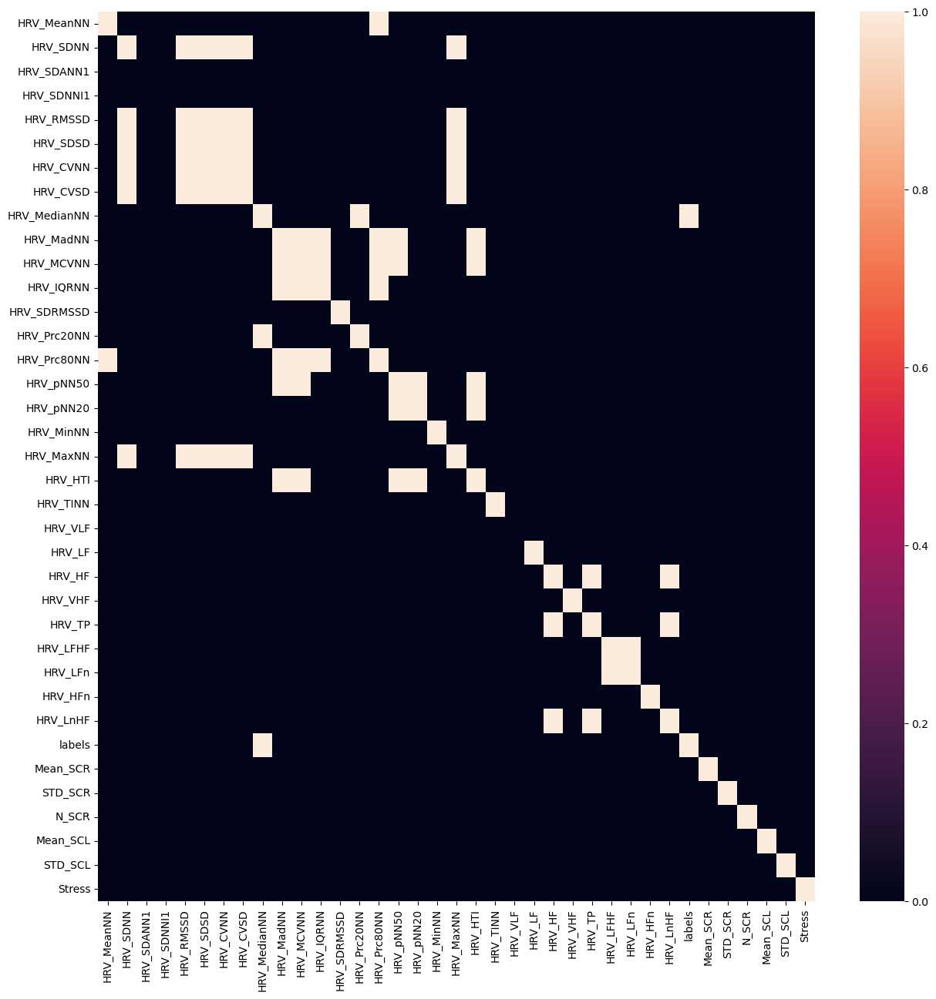

In [10]:
plt.figure(figsize=(15,15))
sns.heatmap(participants_data['S10']['processed_data'].corr() > 0.7)

<AxesSubplot:>

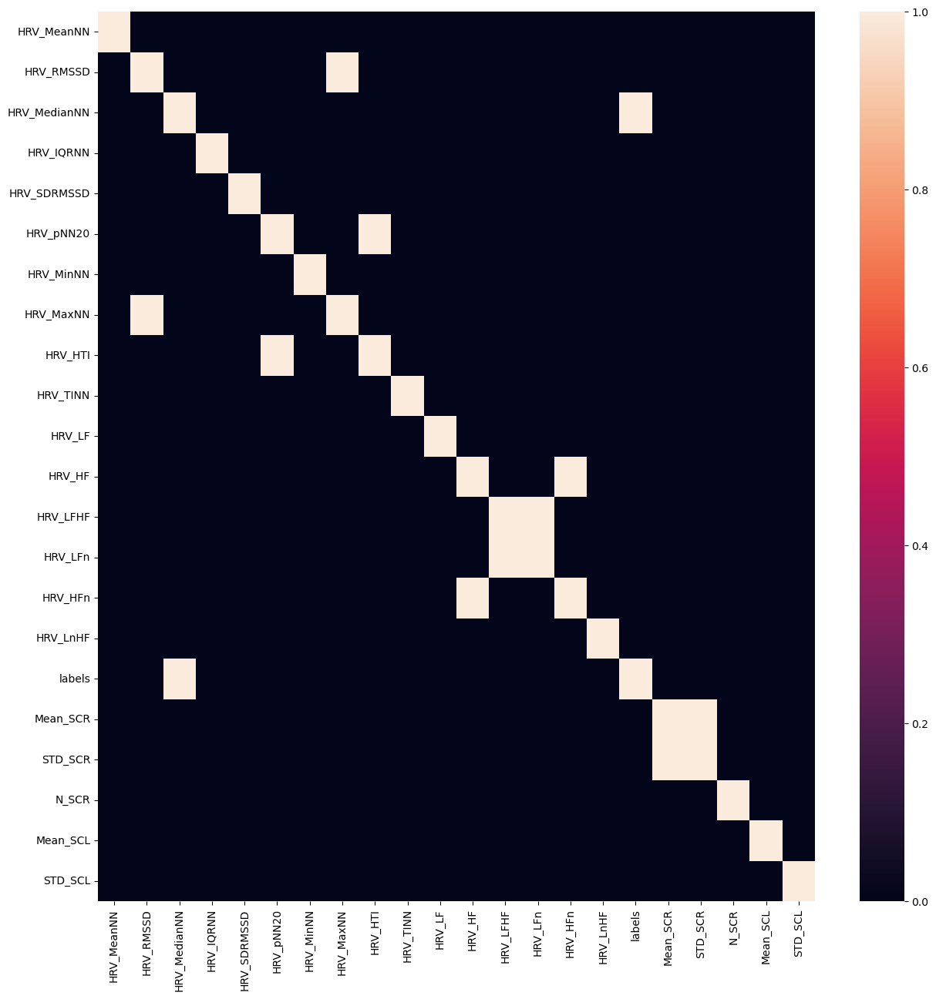

In [11]:
plt.figure(figsize=(15,15))
sns.heatmap(filtered_df['S10'].corr() > 0.7)

4

# TSNE For Individual Participants

In [9]:
from sklearn.manifold import TSNE
from sklearn.preprocessing import MinMaxScaler, StandardScaler

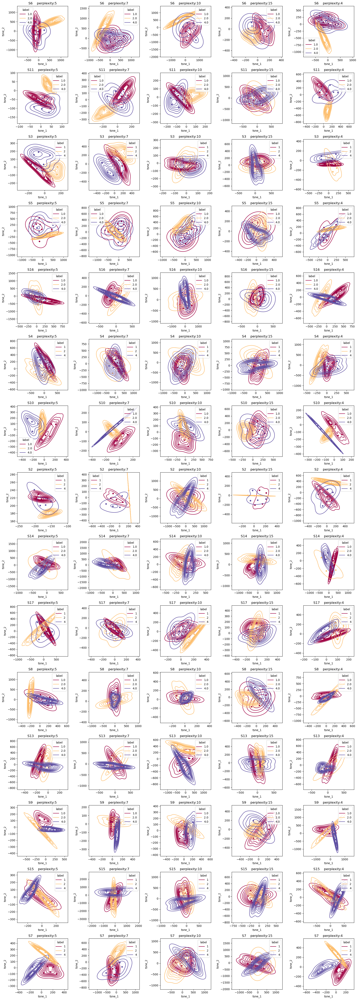

In [52]:
perplexity = [5, 7, 10, 15]
participants = list(filtered_df.keys())

fig, axs = plt.subplots(ncols=len(perplexity)+1, nrows=len(participants), figsize=(18,50))

for i in range(len(participants)):
    for j in range(len(perplexity)+1):
        d = filtered_df[participants[i]]
        
        y = d['labels'].values
        X = d.loc[:, d.columns != "labels"]

        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(X)

        n_components = 2
        if j == len(perplexity):
            p = int(np.average(filtered_df['S10'].labels.value_counts()))
        else:
            p = perplexity[j]
        tsne = TSNE(n_components, perplexity=p)
        tsne_result = tsne.fit_transform(scaled_data)

        tsne_result_df = pd.DataFrame({'tsne_1': tsne_result[:,0], 'tsne_2': tsne_result[:,1], 'label': y})
        sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_result_df, ax=axs[i][j], palette="Spectral")
        sns.kdeplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_result_df, ax=axs[i][j], palette="Spectral")
    
        axs[i][j].set_title(f"{participants[i]}    perplexity:{p}")

plt.tight_layout()

In [49]:
j

3

In [50]:
len(perplexity)

4

# Testing UMAP

In [287]:
import umap

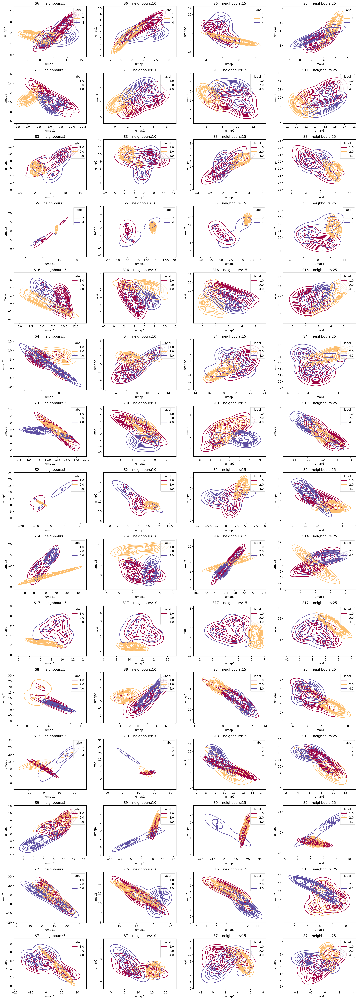

In [288]:
neighbours = [5, 10, 15, 25]
participants = list(filtered_df.keys())

fig, axs = plt.subplots(ncols=len(neighbours), nrows=len(participants), figsize=(18,50))

for i in range(len(participants)):
    for j in range(len(neighbours)):
        d = filtered_df[participants[i]]
        
        y = d['labels'].values
        X = d.loc[:, d.columns != "labels"]

        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(X)

        embedding = umap.UMAP(n_neighbors=neighbours[j], min_dist=0.1).fit_transform(X)

        embedding_df = pd.DataFrame({"umap1":embedding[:, 0], "umap2":embedding[:, 1], "label":y})

        sns.scatterplot(x='umap1', y='umap2', hue='label', data=embedding_df, ax=axs[i][j], palette="Spectral")
        sns.kdeplot(x='umap1', y='umap2', hue='label', data=embedding_df, ax=axs[i][j], palette="Spectral")
    
        axs[i][j].set_title(f"{participants[i]}    neighbours:{neighbours[j]}")

plt.tight_layout()

# Autoencoder

In [12]:
import torch; torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F
import torch.utils
import torch.distributions
import torchvision
import numpy as np
import matplotlib.pyplot as plt; plt.rcParams['figure.dpi'] = 200

In [13]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [263]:
class Encoder(nn.Module):
    def __init__(self, n_features, latent_dims):
        super(Encoder, self).__init__()
        self.linear1 = nn.Linear(n_features, 5)
        self.linear2 = nn.Linear(5, latent_dims)

    def forward(self, x):
        x = torch.flatten(x, start_dim=1)
        x = F.relu(self.linear1(x))
        return self.linear2(x)


class Decoder(nn.Module):
    def __init__(self, n_features, latent_dims):
        super(Decoder, self).__init__()
        self.linear1 = nn.Linear(latent_dims, 5)
        self.linear2 = nn.Linear(5, n_features)

    def forward(self, z):
        z = F.relu(self.linear1(z))
        z = torch.sigmoid(self.linear2(z))
        return z

In [264]:
class Autoencoder(nn.Module):
    def __init__(self, n_features, latent_dims):
        super(Autoencoder, self).__init__()
        self.encoder = Encoder(n_features, latent_dims)
        self.decoder = Decoder(n_features, latent_dims)

    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

In [456]:
def train(autoencoder, x, epochs=20, lr=0.001):
    opt = torch.optim.Adam(autoencoder.parameters(), lr=lr)
    for epoch in range(epochs):
        x = x.to(device) # GPU
        opt.zero_grad()
        x_hat = autoencoder(x)
        loss = ((x - x_hat)**2).sum()
        loss.backward()
        opt.step()
        #if epoch%100 == 0:
            #print(f"epoch: {epoch}, loss:{loss}")
    return autoencoder

In [112]:
def plot_latent(autoencoder, x, y):
    z = autoencoder.encoder(x.to(device))
    z = z.to('cpu').detach().numpy()
    embedding = pd.DataFrame({"dim_1":z[:, 0], "dim_2":z[:, 1], "label":y})
    sns.scatterplot(x="dim_1", y="dim_2", hue="label", data=embedding, palette='Spectral')
    sns.kdeplot(x="dim_1", y="dim_2", hue="label", data=embedding, palette='Spectral')

In [324]:
data = clean_data(participants_data['S2']['full_data'])

In [325]:
y = data['labels'].values
X = data.loc[:, data.columns != "labels"]

In [326]:
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(X)
scaled_data = torch.from_numpy(scaled_data).type(torch.float)

In [269]:
scaled_data.dtype

torch.float32

In [270]:
latent_dims = 2
n_features = X.shape[1] 
autoencoder = Autoencoder(n_features, latent_dims).to(device) # GPU

In [271]:
autoencoder = train(autoencoder, scaled_data, epochs=5000)

epoch: 0, loss:237.67950439453125
epoch: 100, loss:179.43008422851562
epoch: 200, loss:95.4964370727539
epoch: 300, loss:79.55882263183594
epoch: 400, loss:71.56012725830078
epoch: 500, loss:66.56767272949219
epoch: 600, loss:64.5758056640625
epoch: 700, loss:63.41854476928711
epoch: 800, loss:62.50813293457031
epoch: 900, loss:61.566070556640625
epoch: 1000, loss:60.30477523803711
epoch: 1100, loss:58.079864501953125
epoch: 1200, loss:50.63557434082031
epoch: 1300, loss:41.19932556152344
epoch: 1400, loss:38.21608352661133
epoch: 1500, loss:37.093833923339844
epoch: 1600, loss:36.15472412109375
epoch: 1700, loss:35.15172576904297
epoch: 1800, loss:33.972938537597656
epoch: 1900, loss:32.26457214355469
epoch: 2000, loss:31.286563873291016
epoch: 2100, loss:30.449939727783203
epoch: 2200, loss:29.776777267456055
epoch: 2300, loss:29.275196075439453
epoch: 2400, loss:28.904232025146484
epoch: 2500, loss:28.613197326660156
epoch: 2600, loss:28.393218994140625
epoch: 2700, loss:28.22870445

In [272]:
test_y = filtered_df['S2']['labels'].values
test_x = filtered_df['S2'].loc[:, filtered_df['S2'].columns != "labels"]

In [352]:
test_x_scaled = scaler.transform(test_x)
test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)

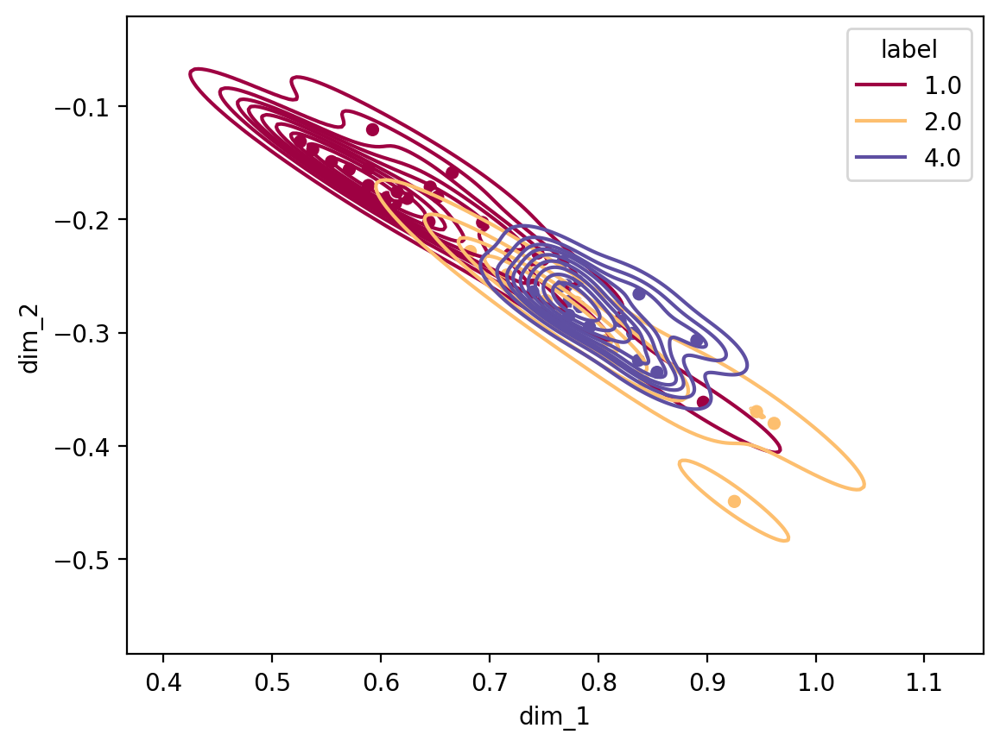

In [353]:
plot_latent(autoencoder, test_x_scaled, test_y)

<AxesSubplot:xlabel='tsne_1', ylabel='tsne_2'>

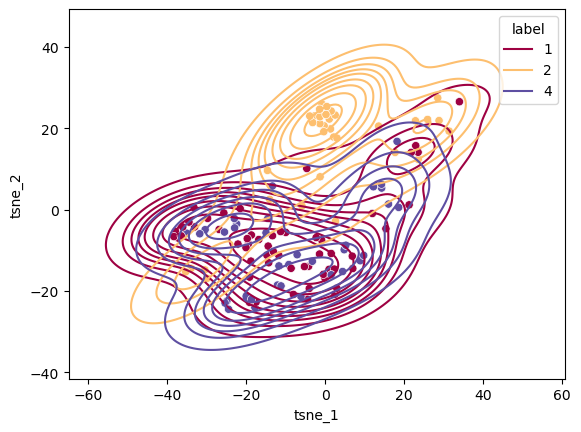

In [57]:
y = combined_data['labels'].values
X = combined_data.loc[:, combined_data.columns != "labels"]

scaler = StandardScaler()
scaled_data = scaler.fit_transform(X)

n_components = 2
tsne = TSNE(n_components, perplexity=int(35/2))
tsne_result = tsne.fit_transform(scaled_data)

tsne_result_df = pd.DataFrame({'tsne_1': tsne_result[:,0], 'tsne_2': tsne_result[:,1], 'label': y})
sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_result_df.loc[(tsne_result_df['label'] == 1) | (tsne_result_df['label'] == 2) | (tsne_result_df['label'] == 4)], palette="Spectral")
sns.kdeplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_result_df.loc[(tsne_result_df['label'] == 1) | (tsne_result_df['label'] == 2) | (tsne_result_df['label'] == 4)], palette="Spectral")

,tsne_1,tsne_2,label
3,-1.395933,15.515244,1
4,-2.566746,15.610239,1
5,-14.947230,15.649180,1
6,-7.751872,-9.634479,1
9,-9.220883,-21.573229,2
...,...,...,...
282,1.443081,12.726569,1
286,14.239859,-6.482224,4
289,34.700642,-18.031521,2
290,-3.546082,-20.680531,2


In [23]:
combined_data

,HRV_MeanNN,HRV_SDANN1,HRV_SDNNI1,HRV_RMSSD,HRV_MedianNN,HRV_IQRNN,HRV_pNN20,HRV_MinNN,HRV_MaxNN,HRV_HTI,...,HRV_LFHF,HRV_LFn,HRV_HFn,HRV_LnHF,labels,Mean_SCR,STD_SCR,N_SCR,Mean_SCL,STD_SCL
0,872.494534,38.309887,238.344040,357.742446,859.375,296.87500,89.212828,328.125,1750.000,20.176471,...,0.573677,0.279563,0.487318,-2.674172,0,0.148424,0.146376,21,0.004624,0.177076
1,832.216226,37.200766,227.042182,335.678066,812.500,257.81250,87.186630,328.125,2156.250,21.117647,...,0.454728,0.274457,0.603564,-2.354516,0,0.076890,0.088110,18,0.189791,0.153602
2,868.531341,34.458374,239.972804,338.584891,859.375,265.62500,87.463557,312.500,1796.875,16.333333,...,0.427759,0.229309,0.536069,-2.664111,0,0.066851,0.063295,2,-0.563069,0.249199
3,881.544985,25.189395,204.199907,293.414509,906.250,234.37500,86.135693,312.500,1750.000,16.950000,...,0.516251,0.280498,0.543337,-2.270814,1,0.000000,0.000000,0,-1.054406,0.047445
4,848.588423,21.755564,217.965498,305.361623,875.000,250.00000,83.806818,312.500,1671.875,15.304348,...,0.496318,0.238388,0.480313,-2.780611,1,0.000000,0.000000,0,-1.150773,0.018791
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291,1005.508475,291.391745,804.648721,1285.871869,890.625,468.75000,95.254237,312.500,14281.250,22.692308,...,52.693646,0.535865,0.010169,-7.777574,0,0.072025,0.109870,16,1.348943,0.363943
292,852.831197,42.093935,232.744445,318.298875,859.375,296.87500,90.883191,312.500,1703.125,20.647059,...,0.495929,0.260940,0.526164,-2.654376,0,0.190012,0.115923,3,0.738306,0.204246
293,1106.134259,286.877808,772.848811,1231.306993,984.375,359.37500,94.444444,328.125,10031.250,24.545455,...,27.335754,0.627392,0.022951,-7.018930,0,0.163792,0.178637,8,-0.657654,0.109681
294,915.212807,66.708744,236.874351,284.112040,906.250,359.37500,85.276074,312.500,1703.125,20.375000,...,1.692554,0.560887,0.331385,-4.408908,4,0.220689,0.043060,2,-0.551843,0.111731


# On complete data

In [12]:
combined_data = pd.DataFrame([])

for participant in participants:
    d = participants_data[participant]['full_data']
    combined_data = pd.concat([combined_data, clean_data(d)])

In [13]:
combined_data = combined_data.reset_index(drop=True)

In [14]:
y = combined_data['labels'].values
X = combined_data.loc[:, combined_data.columns != "labels"]

In [374]:
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(X)
scaled_data = torch.from_numpy(scaled_data).type(torch.float)

In [375]:
latent_dims = 2
n_features = X.shape[1] 
autoencoder = Autoencoder(n_features, latent_dims).to(device) # GPU

In [376]:
autoencoder = train(autoencoder, scaled_data, epochs=1000, lr=0.01)

epoch: 0, loss:3365.468505859375
epoch: 100, loss:327.20928955078125
epoch: 200, loss:294.5140380859375
epoch: 300, loss:286.27099609375
epoch: 400, loss:268.6124267578125
epoch: 500, loss:253.01596069335938
epoch: 600, loss:223.36050415039062
epoch: 700, loss:207.31454467773438
epoch: 800, loss:194.40066528320312
epoch: 900, loss:189.4642333984375


In [377]:
test_y = filtered_df['S2']['labels'].values
test_x = filtered_df['S2'].loc[:, filtered_df['S2'].columns != "labels"]

In [378]:
test_x_scaled = scaler.transform(test_x)
test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)

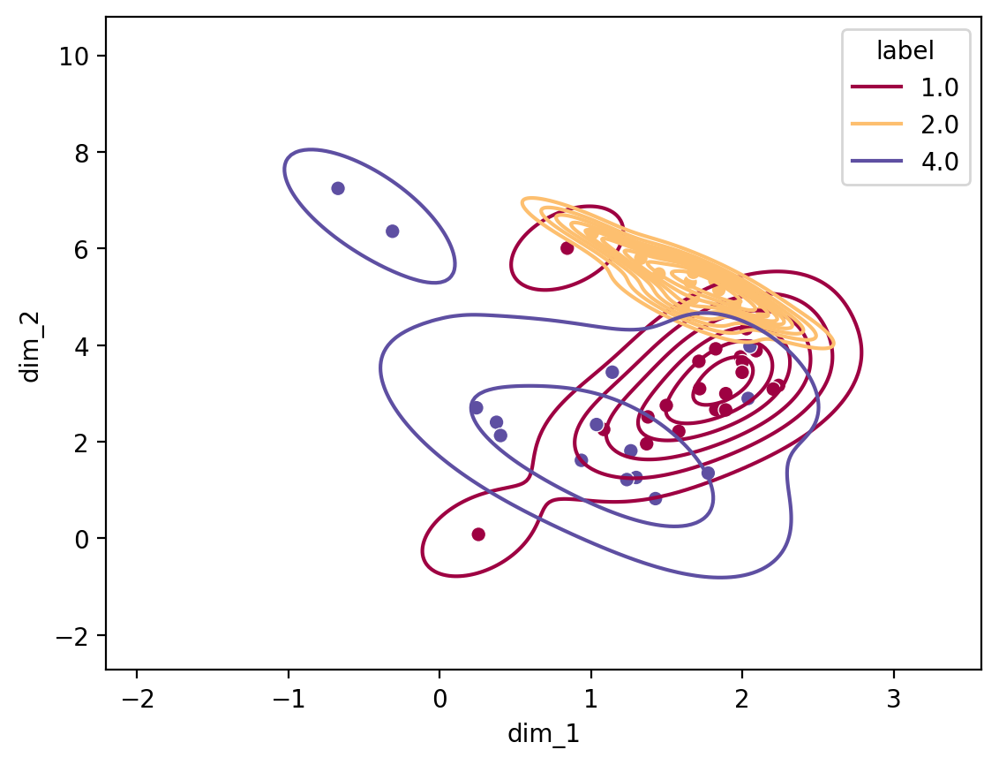

In [379]:
plot_latent(autoencoder, test_x_scaled, test_y)

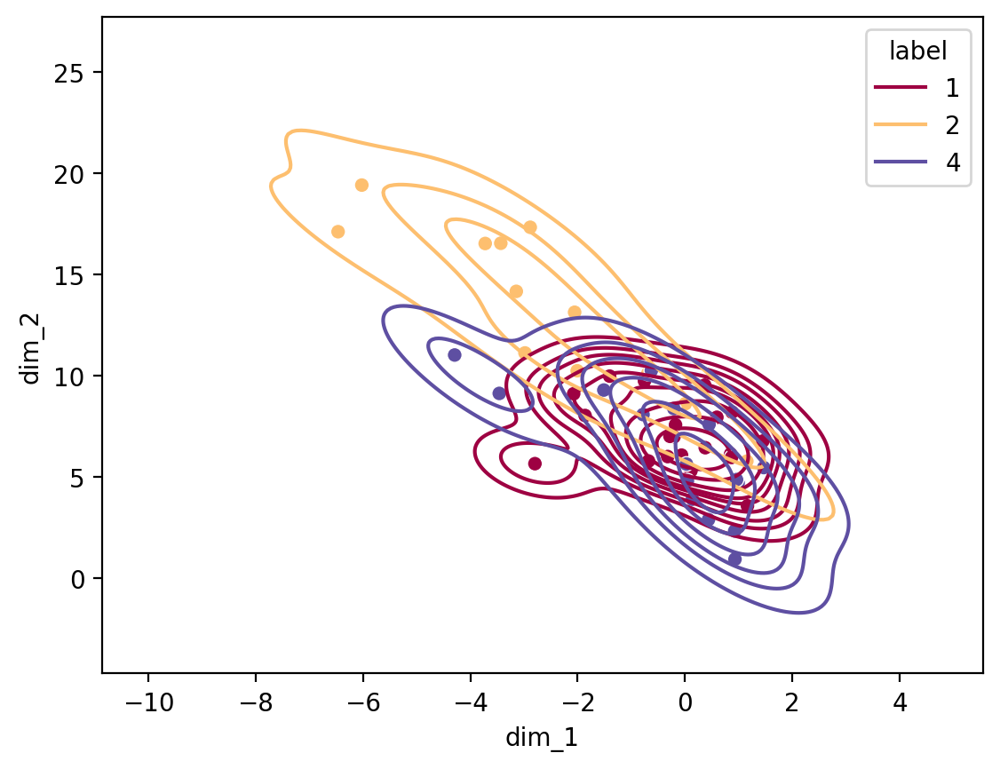

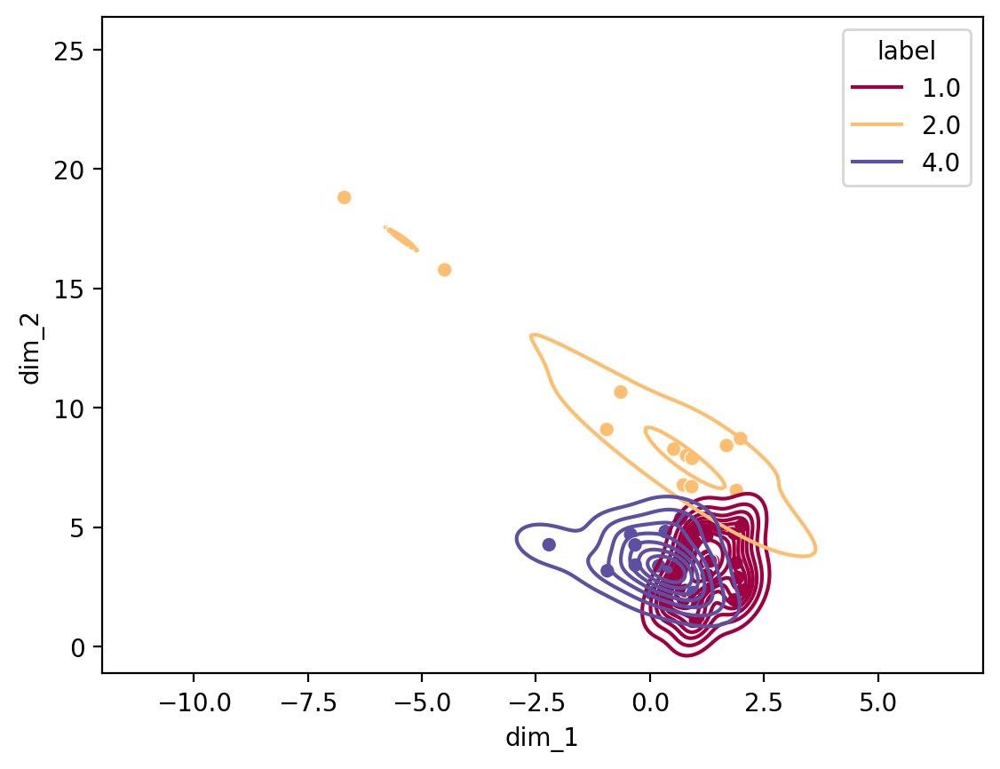

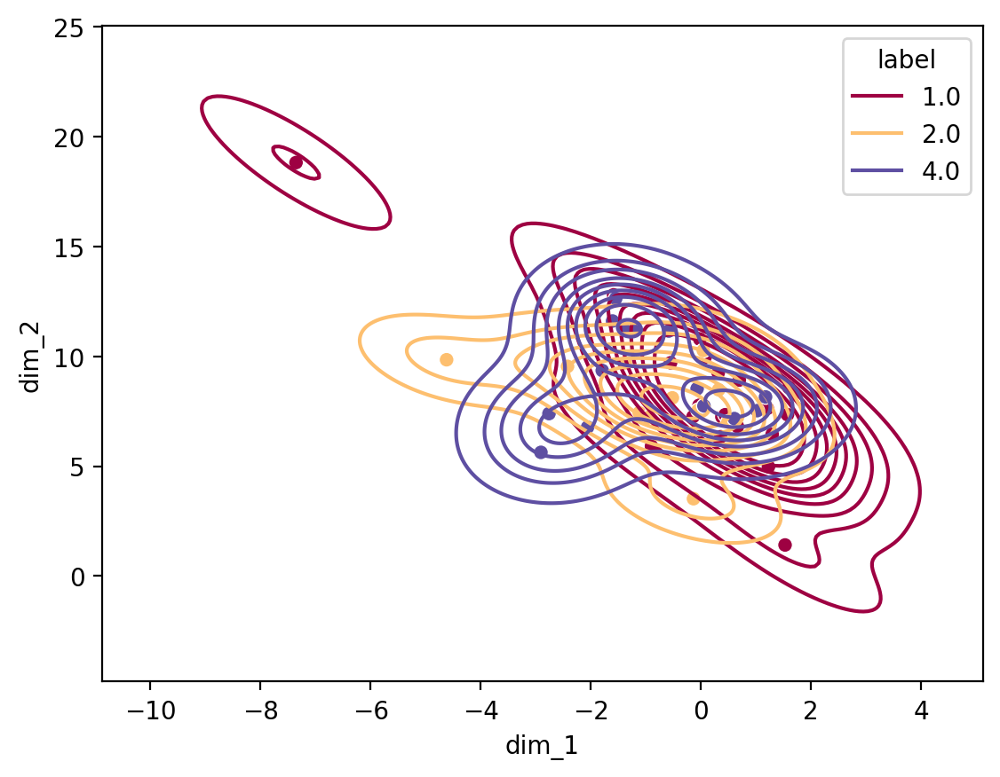

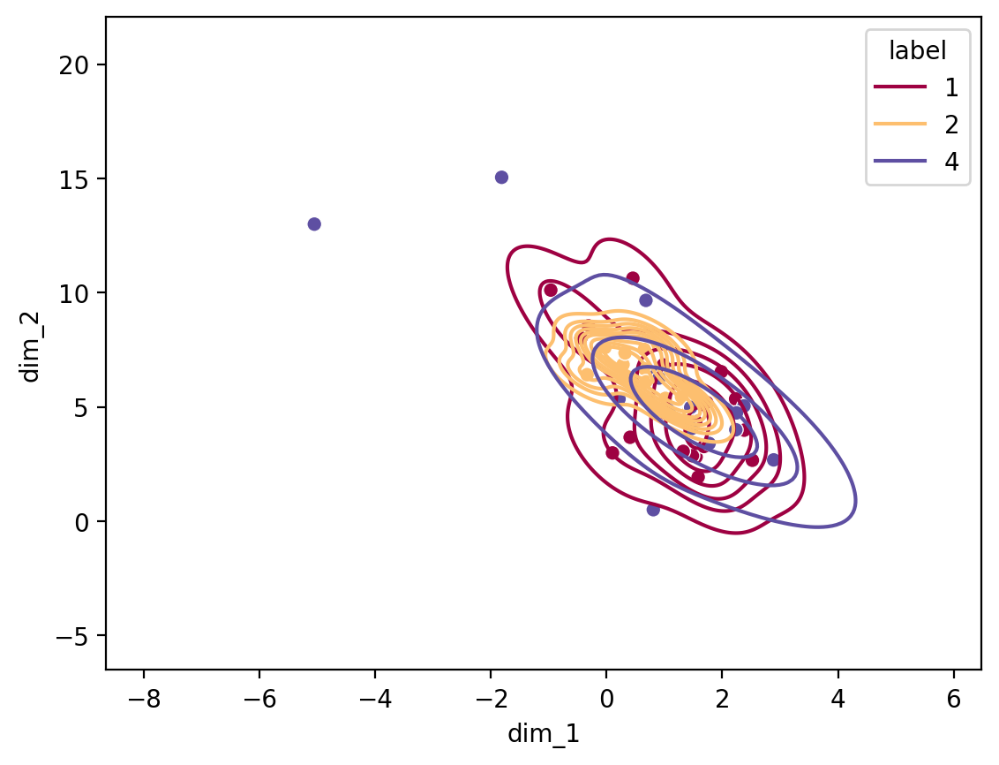

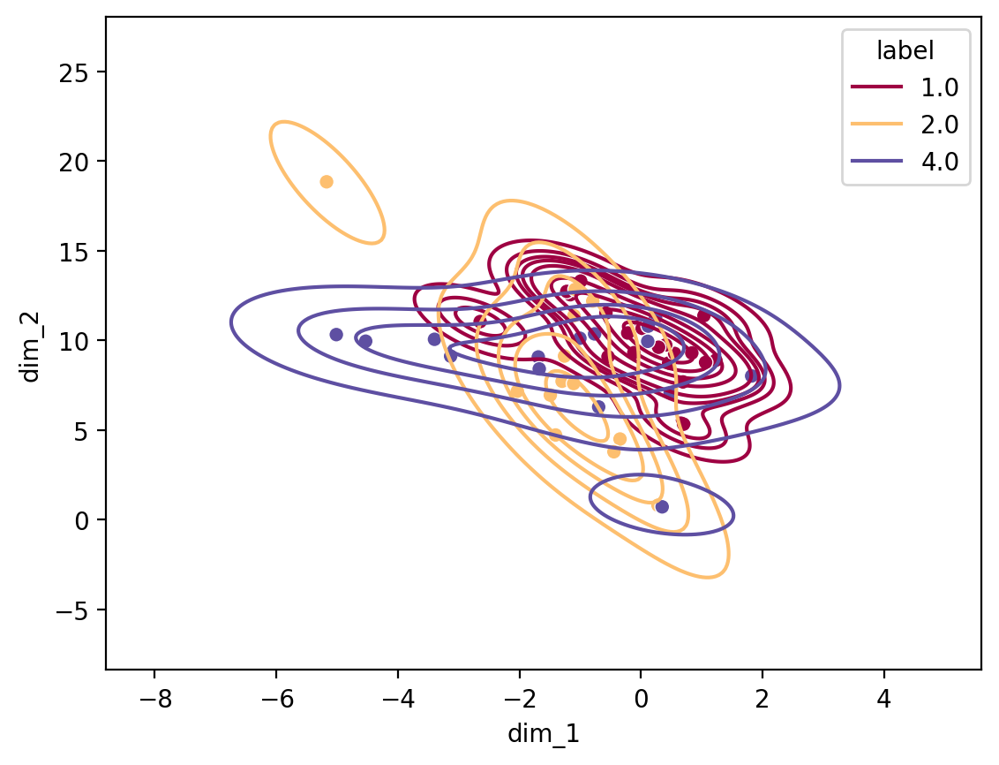

...

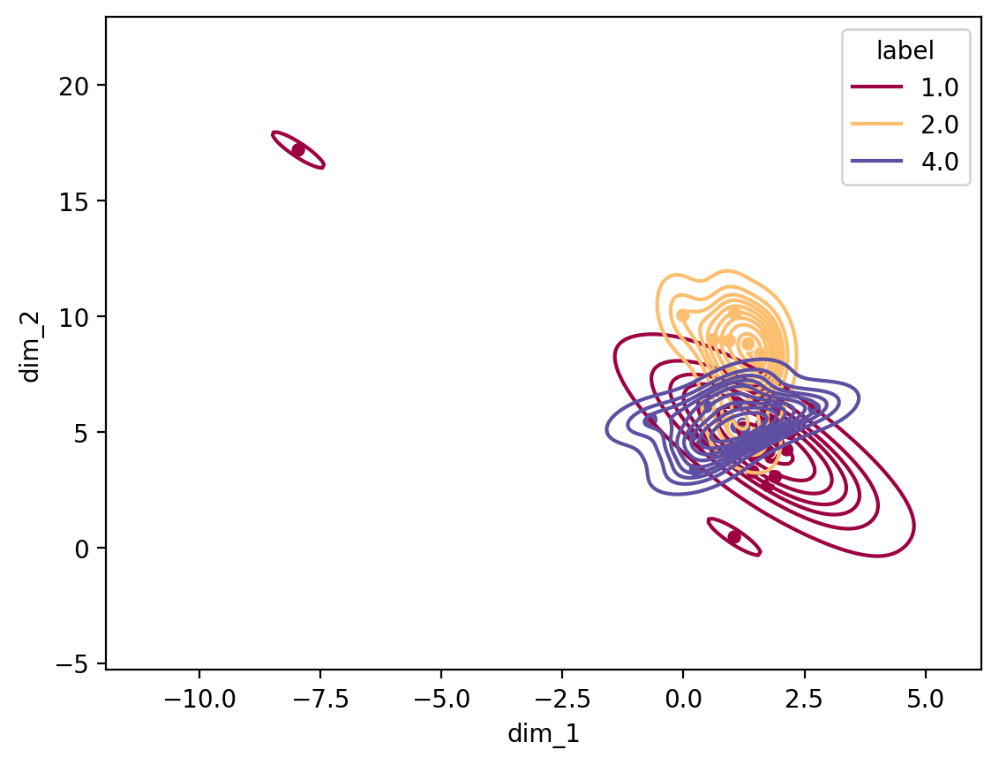

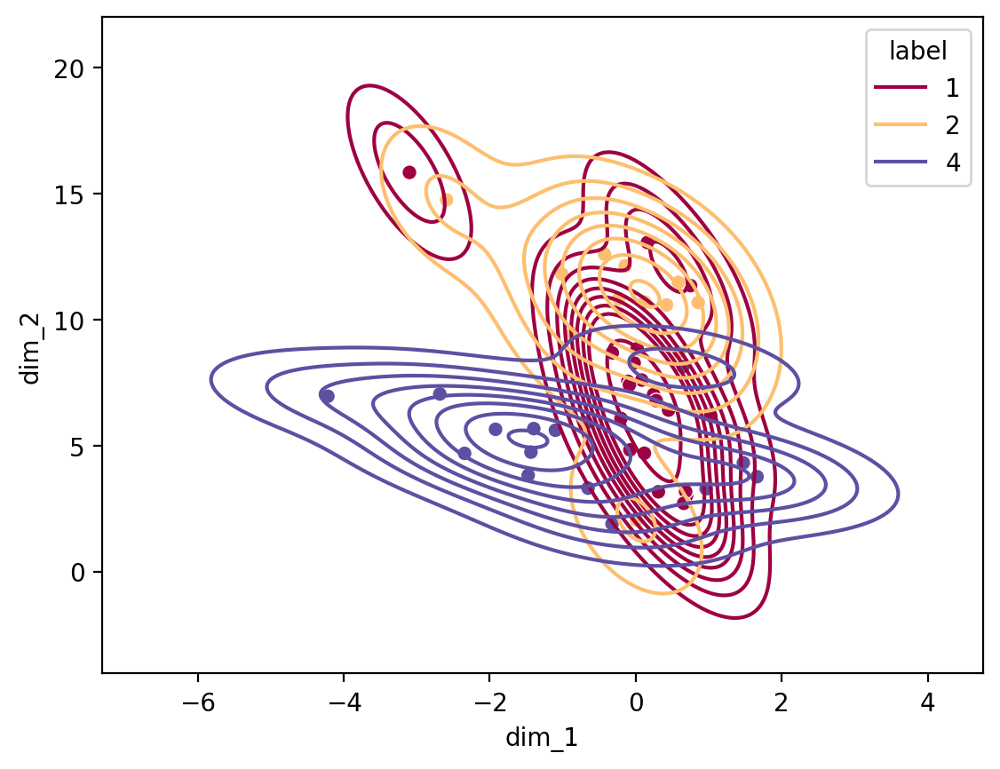

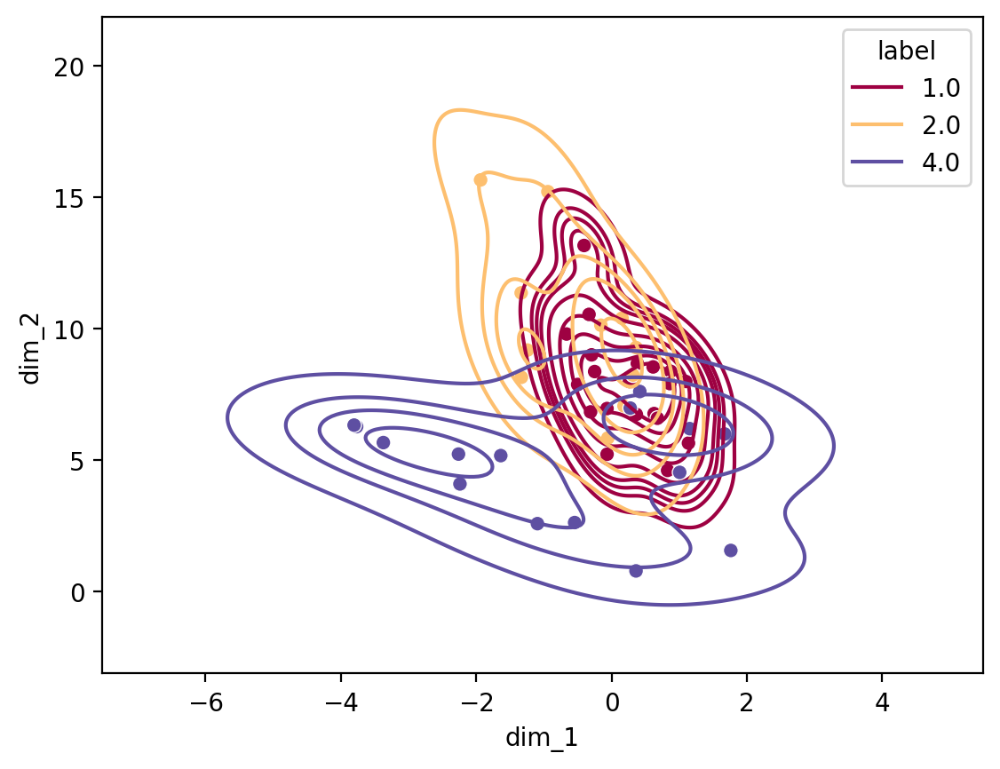

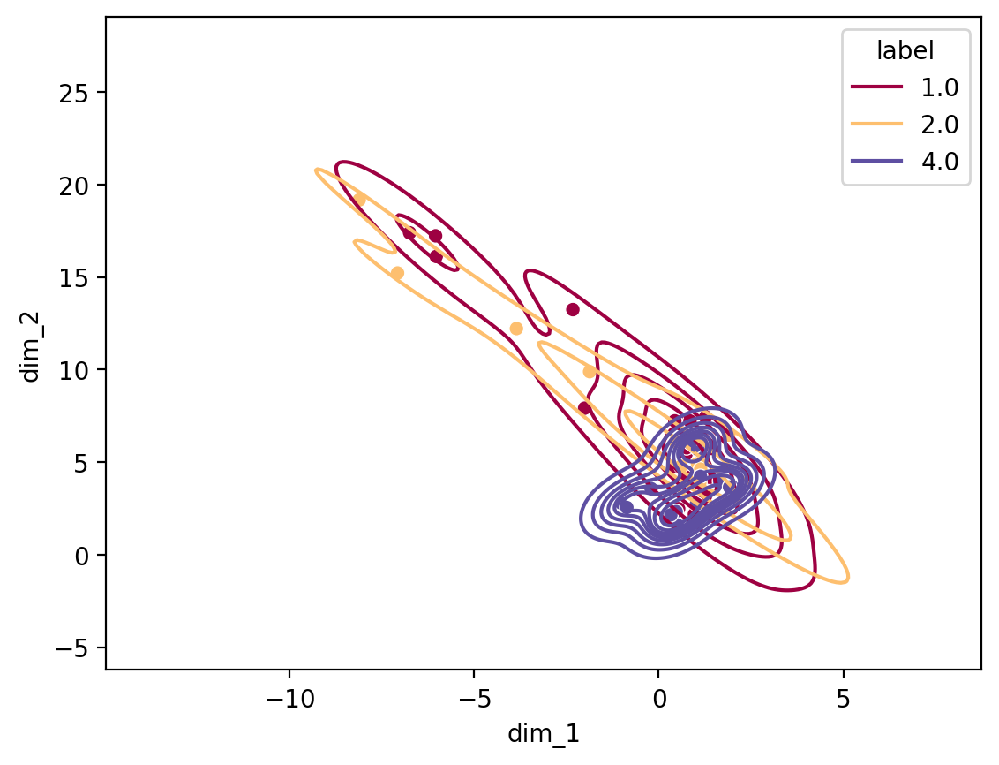

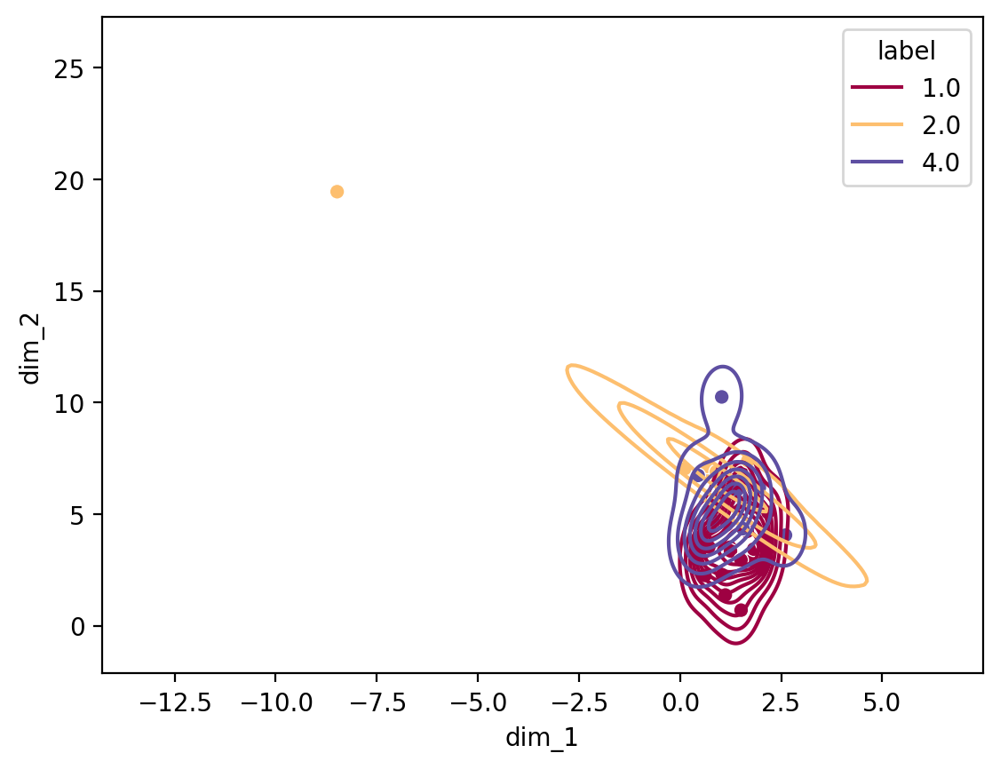

In [380]:
for participant in participants:
    test_y = filtered_df[participant]['labels'].values
    test_x = filtered_df[participant].loc[:, filtered_df[participant].columns != "labels"]
    
    test_x_scaled = scaler.fit_transform(test_x)
    test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)
    
    plot_latent(autoencoder, test_x_scaled, test_y)
    plt.show()

# Getting Stroop Data

In [290]:
import pickle

In [383]:
data_location = "/home/prabhaka/Documents/HiWi/RP2_Files/Plots/stroop.pkl"

In [394]:
with open(data_location, 'rb') as f:
    stroop_data = pickle.load(f) 

In [395]:
stroop_data = stroop_data.drop(columns=["Time", "Subject_ID", "Condition", "HRV_SDANN1", "HRV_SDNNI1"])

In [396]:
stroop_data = clean_data(stroop_data)

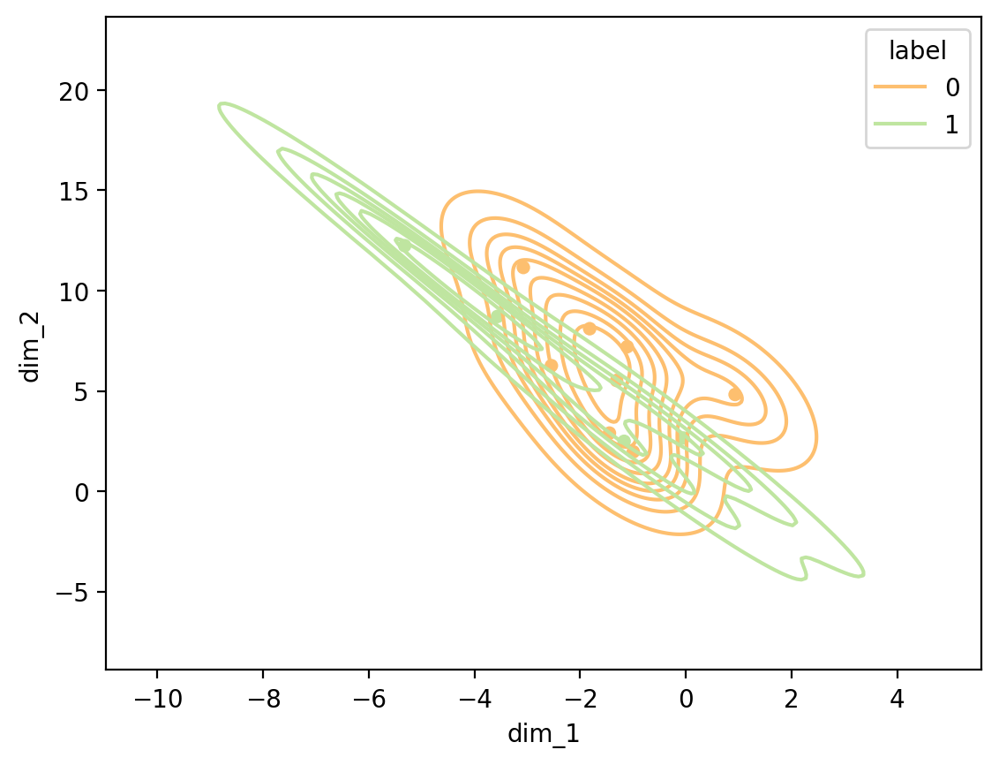

In [398]:
test_y = stroop_data['Stress_Status'].values
test_x = stroop_data.loc[:, stroop_data.columns != "Stress_Status"]

test_x_scaled = scaler.transform(test_x)
test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)

plot_latent(autoencoder, test_x_scaled, test_y)

# Variational Autoencoder

In [409]:
class VariationalEncoder(nn.Module):
    def __init__(self, n_features, latent_dims):
        super(VariationalEncoder, self).__init__()
        self.linear1 = nn.Linear(n_features, 10)
        self.linear2 = nn.Linear(10, latent_dims)
        self.linear3 = nn.Linear(10, latent_dims)

        self.N = torch.distributions.Normal(0, 1)
        self.N.loc = self.N.loc.cuda() # hack to get sampling on the GPU
        self.N.scale = self.N.scale.cuda()
        self.kl = 0

    def forward(self, x):
        x = torch.flatten(x, start_dim=1)
        x = F.relu(self.linear1(x))
        mu =  self.linear2(x)
        sigma = torch.exp(self.linear3(x))
        z = mu + sigma*self.N.sample(mu.shape)
        self.kl = (sigma**2 + mu**2 - torch.log(sigma) - 1/2).sum()
        return z

class Decoder(nn.Module):
    def __init__(self, n_features, latent_dims):
        super(Decoder, self).__init__()
        self.linear1 = nn.Linear(latent_dims, 10)
        self.linear2 = nn.Linear(10, n_features)

    def forward(self, z):
        z = F.relu(self.linear1(z))
        z = torch.sigmoid(self.linear2(z))
        return z

In [410]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, n_features, latent_dims):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VariationalEncoder(n_features, latent_dims)
        self.decoder = Decoder(n_features, latent_dims)

    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

In [411]:
def train(autoencoder, x, epochs=20, lr=0.001):
    opt = torch.optim.Adam(autoencoder.parameters(), lr=lr)
    for epoch in range(epochs):
        x = x.to(device) # GPU
        opt.zero_grad()
        x_hat = autoencoder(x)
        loss = ((x - x_hat)**2).sum() + autoencoder.encoder.kl
        loss.backward()
        opt.step()
        if epoch%100 == 0:
            print(f"epoch: {epoch}, loss:{loss}")
    return autoencoder

In [412]:
y = combined_data['labels'].values
X = combined_data.loc[:, combined_data.columns != "labels"]

scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(X)
scaled_data = torch.from_numpy(scaled_data).type(torch.float)

n_features = X.shape[1]

In [423]:
vae = VariationalAutoencoder(n_features, latent_dims).to(device) # GPU
vae = train(vae, scaled_data, epochs=10000, lr=0.001)

epoch: 0, loss:5176.08203125
epoch: 100, loss:3321.9482421875
epoch: 200, loss:2200.16845703125
epoch: 300, loss:1786.6181640625
epoch: 400, loss:1585.4244384765625
epoch: 500, loss:1512.642822265625
epoch: 600, loss:1483.021240234375
epoch: 700, loss:1466.397705078125
epoch: 800, loss:1460.311767578125
epoch: 900, loss:1455.8759765625
epoch: 1000, loss:1451.9544677734375
epoch: 1100, loss:1450.0982666015625
epoch: 1200, loss:1448.40576171875
epoch: 1300, loss:1447.0159912109375
epoch: 1400, loss:1444.720947265625
epoch: 1500, loss:1444.80615234375
epoch: 1600, loss:1444.809814453125
epoch: 1700, loss:1443.60498046875
epoch: 1800, loss:1443.752685546875
epoch: 1900, loss:1443.10986328125
epoch: 2000, loss:1442.9156494140625
epoch: 2100, loss:1442.133056640625
epoch: 2200, loss:1442.52001953125
epoch: 2300, loss:1442.4459228515625
epoch: 2400, loss:1442.090576171875
epoch: 2500, loss:1441.1722412109375
epoch: 2600, loss:1441.21826171875
epoch: 2700, loss:1441.6678466796875
epoch: 2800, 

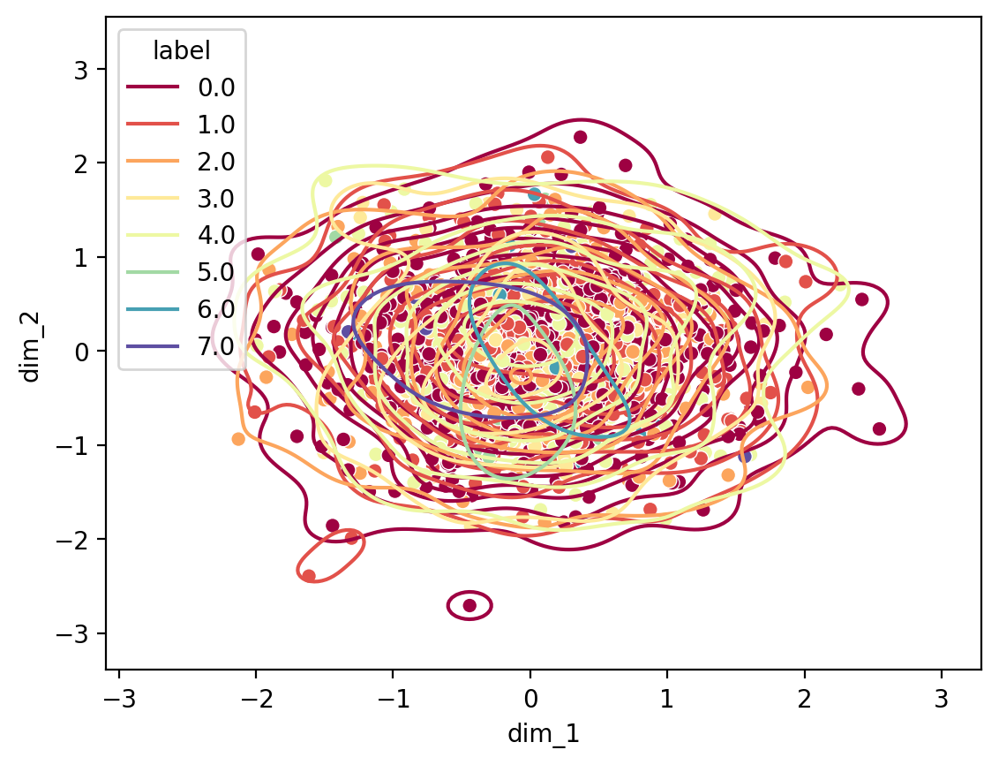

In [424]:
plot_latent(vae, scaled_data, y)

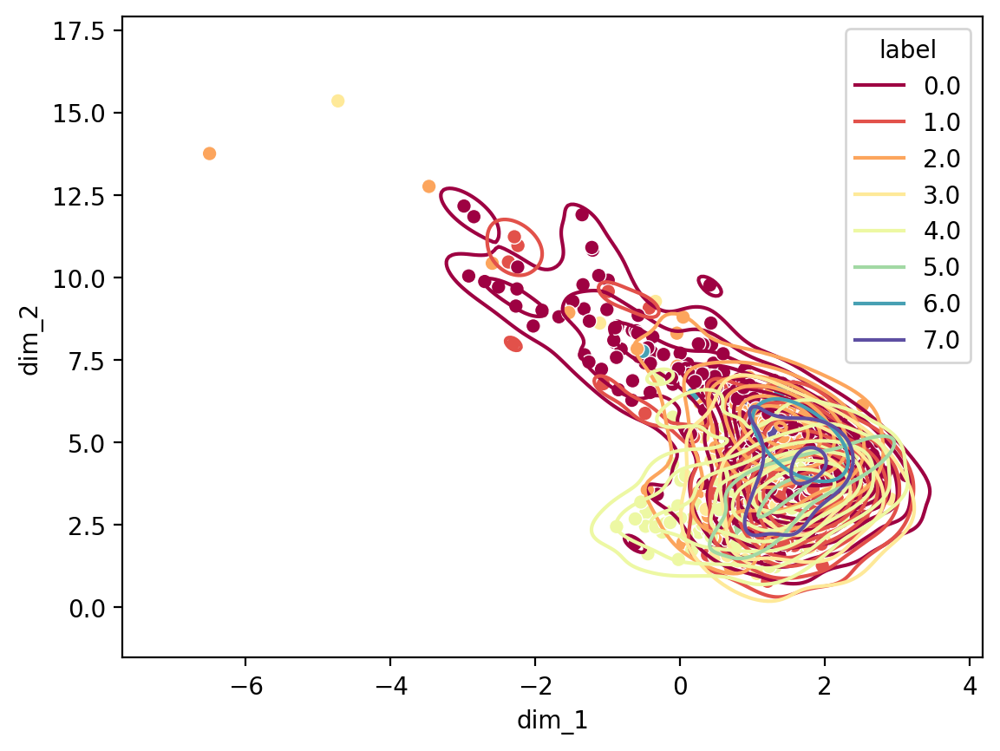

In [425]:
plot_latent(autoencoder, scaled_data, y)

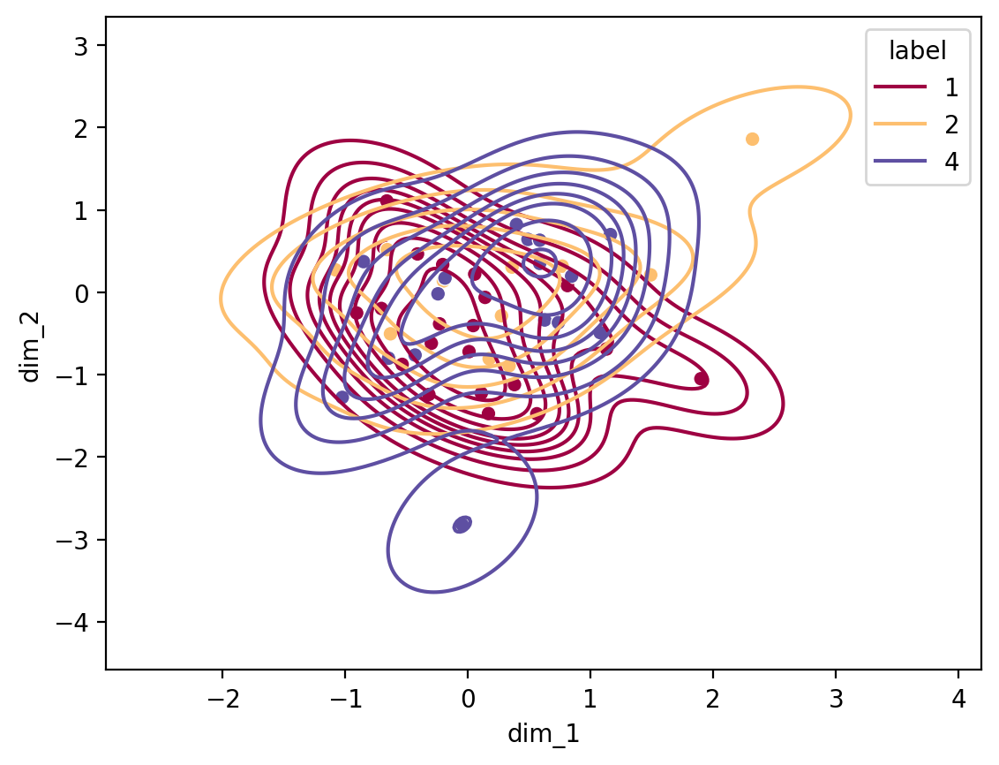

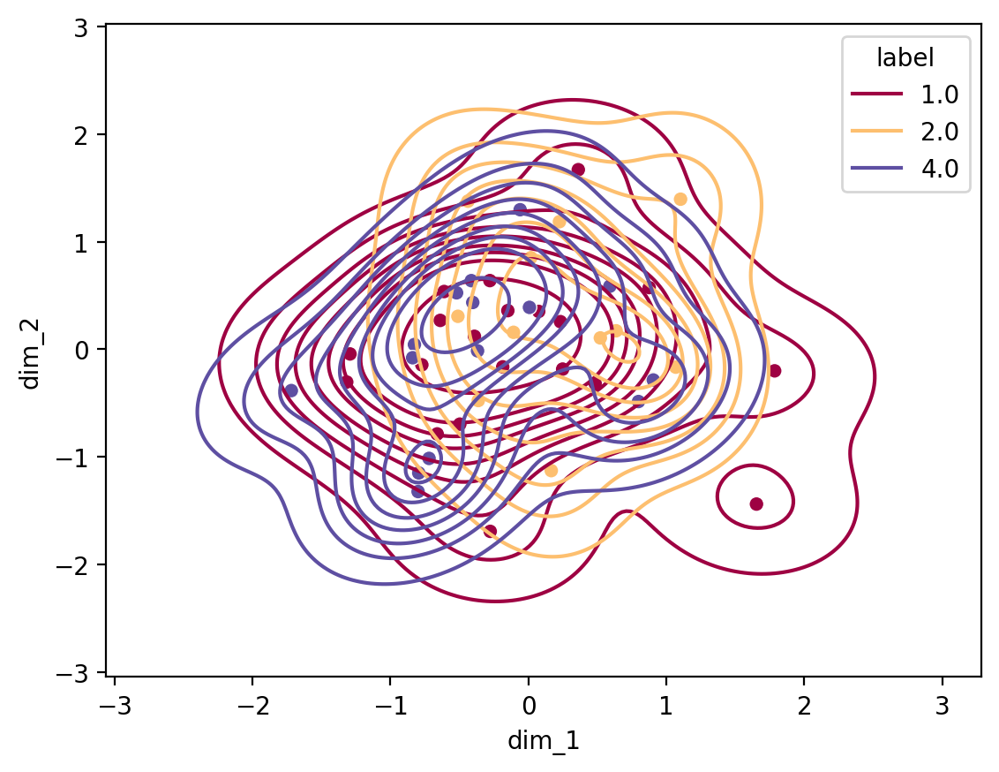

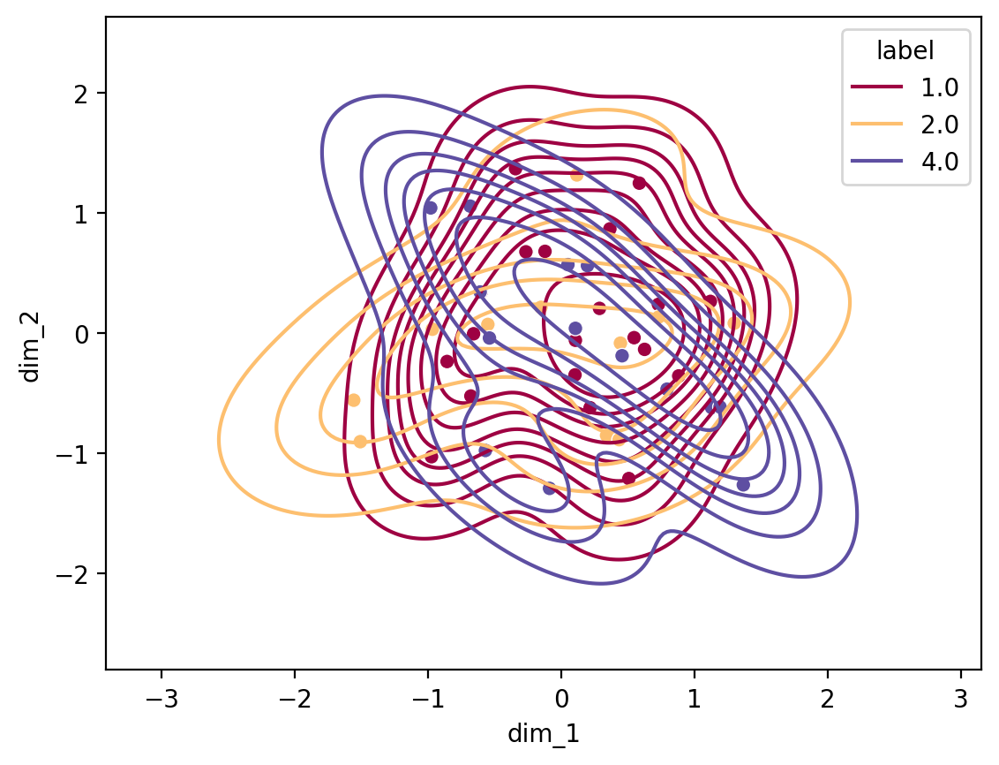

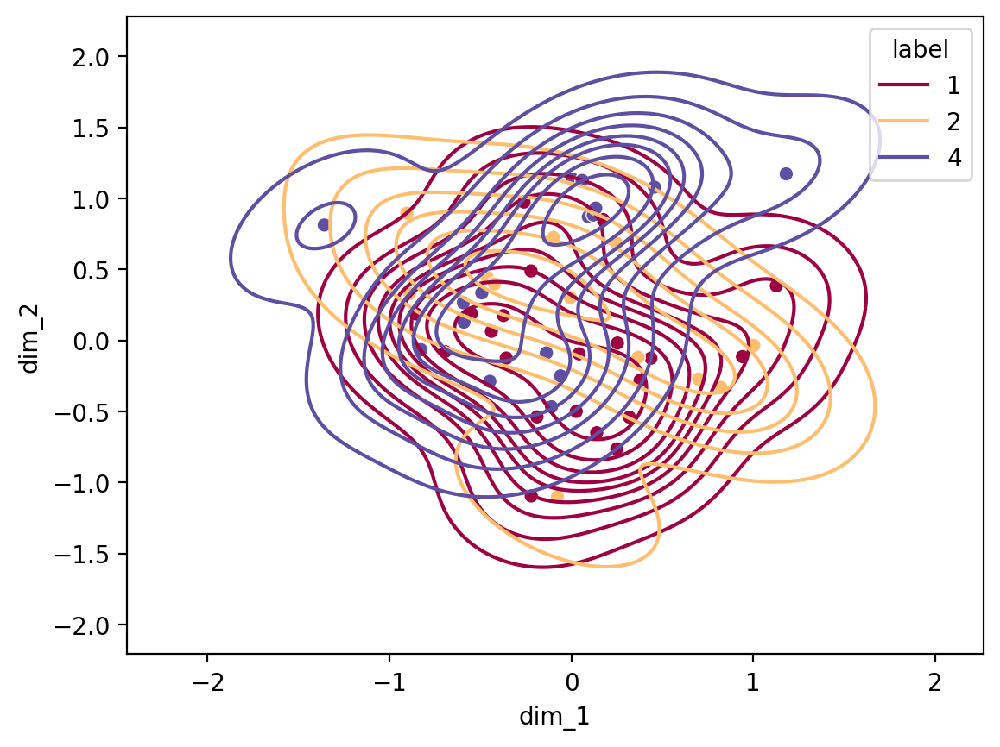

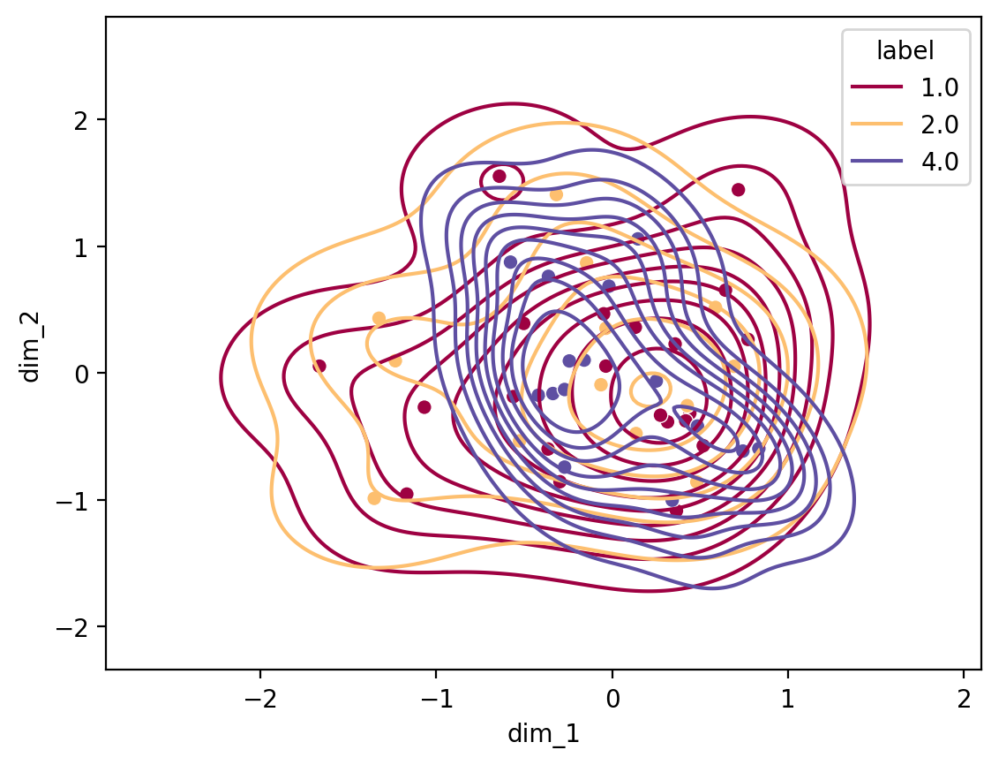

...

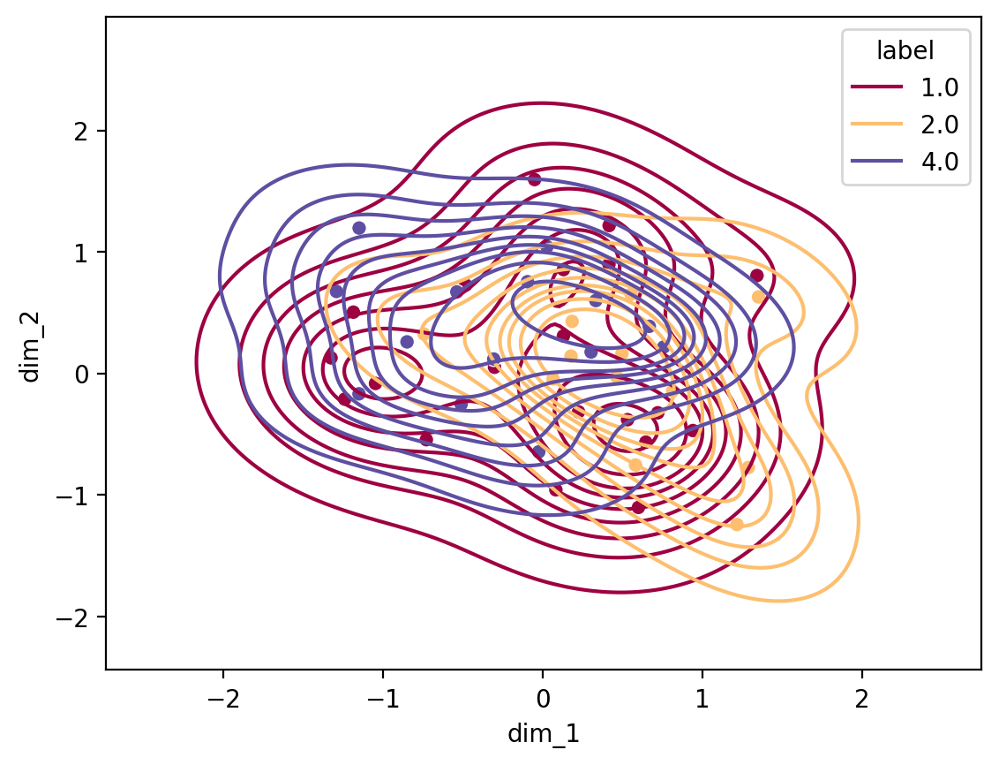

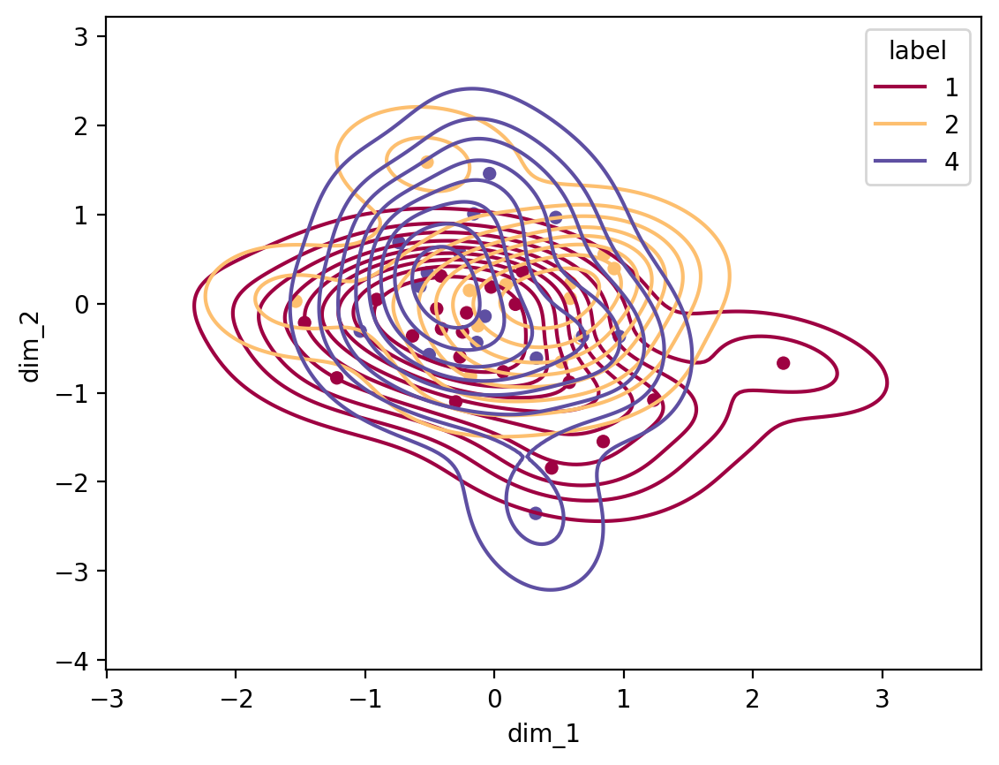

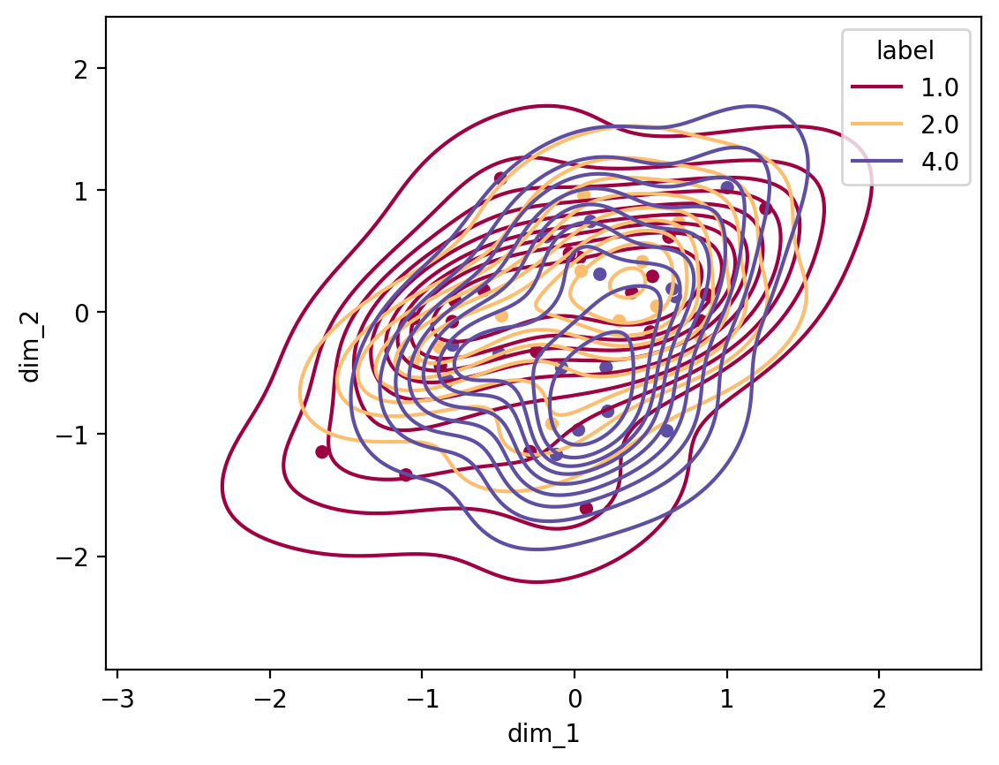

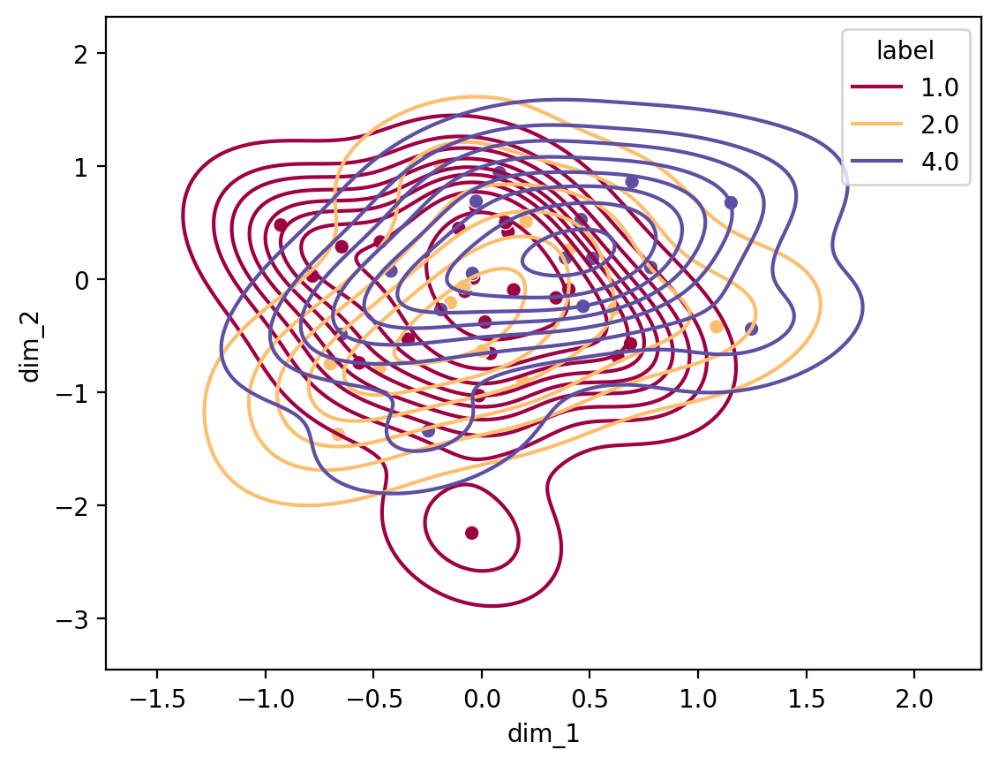

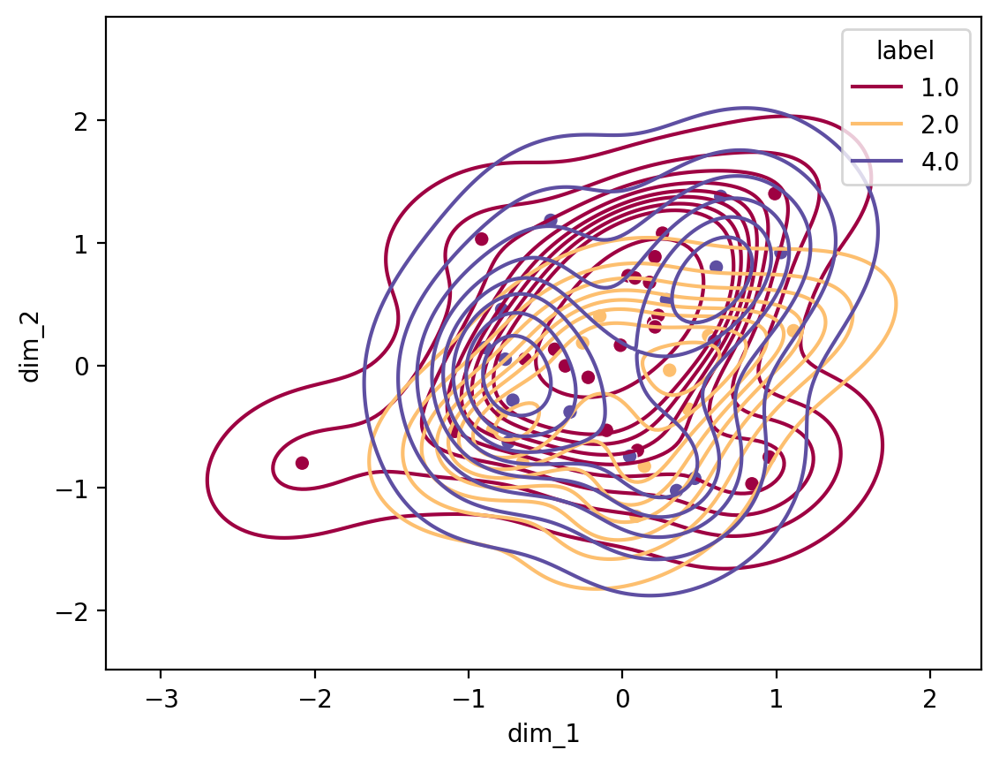

In [426]:
for participant in participants:
    test_y = filtered_df[participant]['labels'].values
    test_x = filtered_df[participant].loc[:, filtered_df[participant].columns != "labels"]
    
    test_x_scaled = scaler.transform(test_x)
    test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)
    
    plot_latent(vae, test_x_scaled, test_y)
    plt.show()

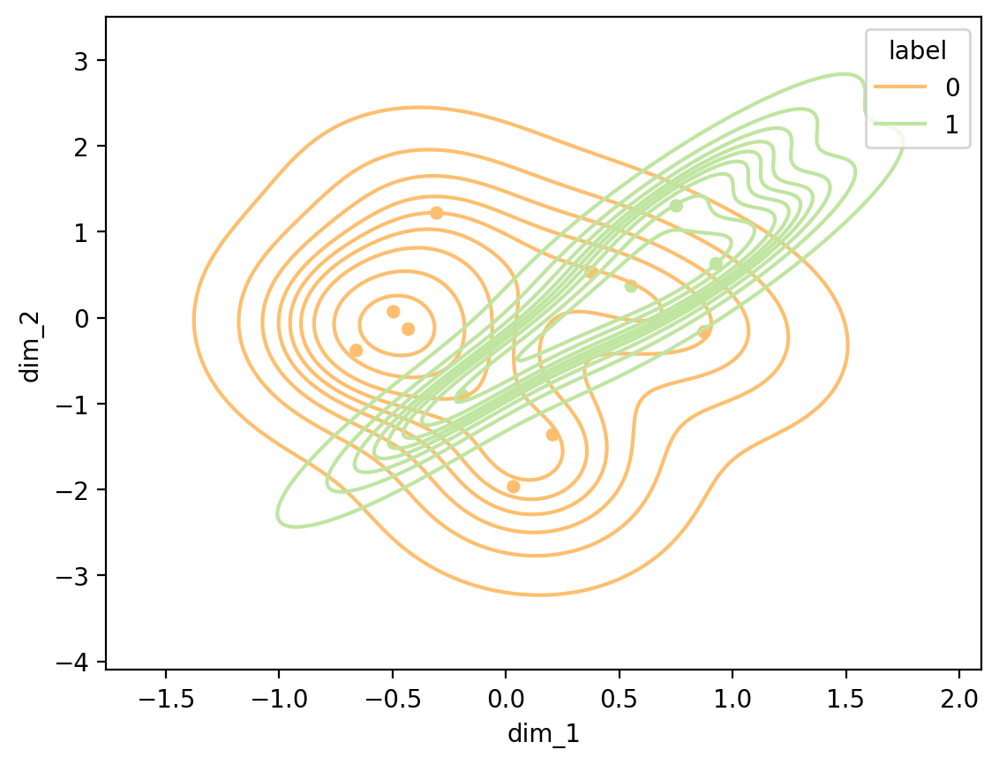

In [427]:
test_y = stroop_data['Stress_Status'].values
test_x = stroop_data.loc[:, stroop_data.columns != "Stress_Status"]

test_x_scaled = scaler.transform(test_x)
test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)

plot_latent(vae, test_x_scaled, test_y)

In [428]:
data_location = "/home/prabhaka/Documents/HiWi/DGPPN/processed_data/depressed_data.pkl"

In [429]:
with open(data_location, 'rb') as f:
    depressed_data = pickle.load(f) 

In [431]:
col_names = X.columns

In [432]:
hrv_cols = [col for col in col_names if "HRV" in col]
eda_cols = [col for col in col_names if "HRV" not in col]

In [433]:
conditions = ["baseline", "intervention", "post"]
combined_depressed_data = pd.DataFrame([])

for ids in depressed_data.keys():
    for intervention in depressed_data[ids].keys():
        for condition in conditions:
            h = depressed_data[ids][intervention][condition]["hrv"][depressed_data[ids][intervention][condition]["hrv"].columns.intersection(hrv_cols)]
            e = depressed_data[ids][intervention][condition]["eda"][0][depressed_data[ids][intervention][condition]["eda"][0].columns.intersection(eda_cols)]
            
            if condition == "baseline" or condition == "post":
                l = np.zeros(len(h))
            elif intervention == "SIGMA":
                l = np.ones(len(h))                
            elif intervention == "MBI":
                l = np.ones(len(h))*-1
            l = pd.DataFrame({"Stress":l})
            d = pd.concat([h,e,l], axis=1)
            combined_depressed_data = pd.concat([combined_depressed_data, d], axis=0)

combined_depressed_data = combined_depressed_data.reset_index(drop=True).dropna()

In [434]:
y = combined_depressed_data['Stress'].values
X = combined_depressed_data.loc[:, combined_depressed_data.columns != "Stress"]

In [436]:
scaled_depressed_data = scaler.transform(X)

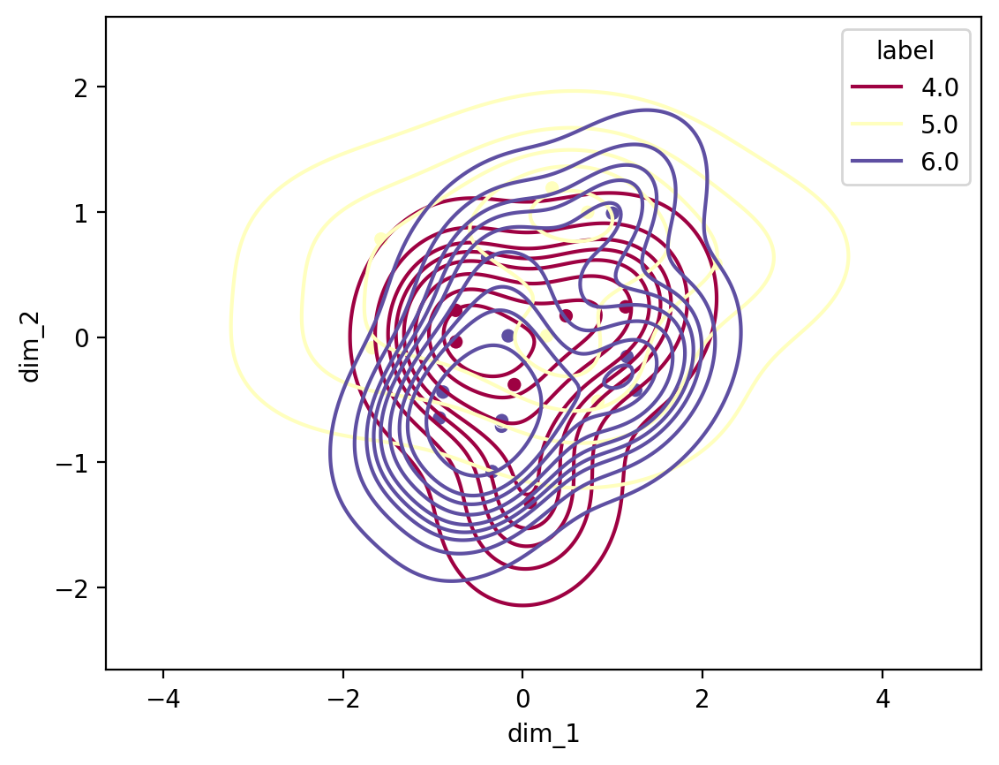

In [448]:
test_x_scaled = torch.from_numpy(scaled_depressed_data).type(torch.float)

plot_latent(vae, test_x_scaled, y+5)

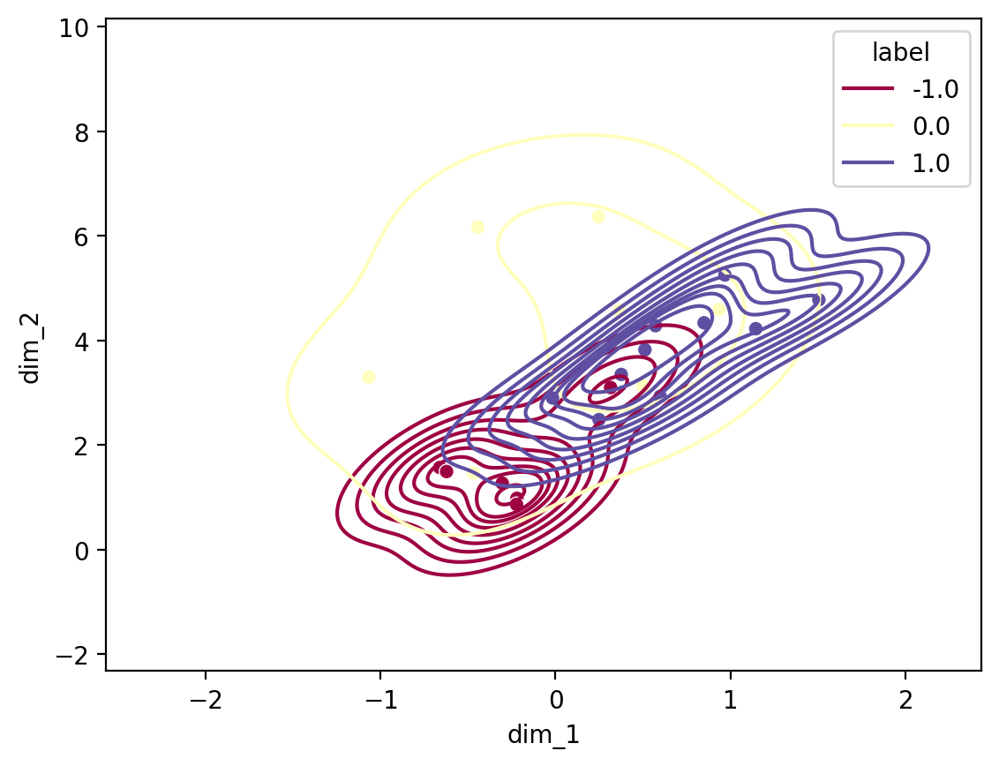

In [454]:
plot_latent(autoencoder, test_x_scaled, y)

# Training an Autoencoder for individual

S6


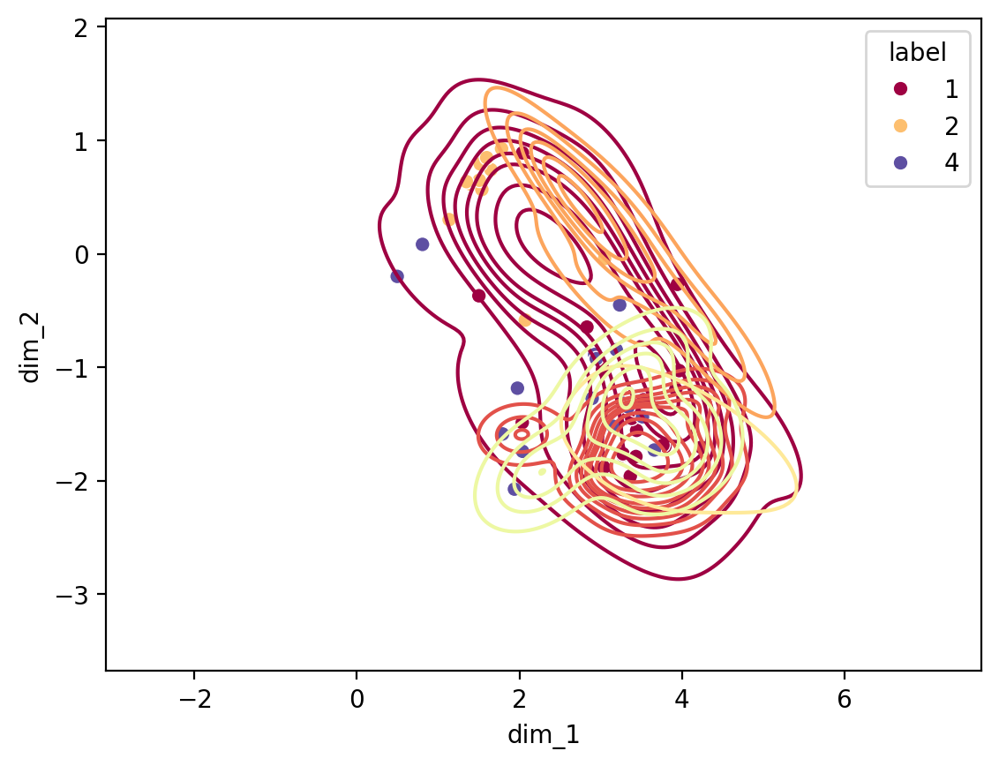

S11


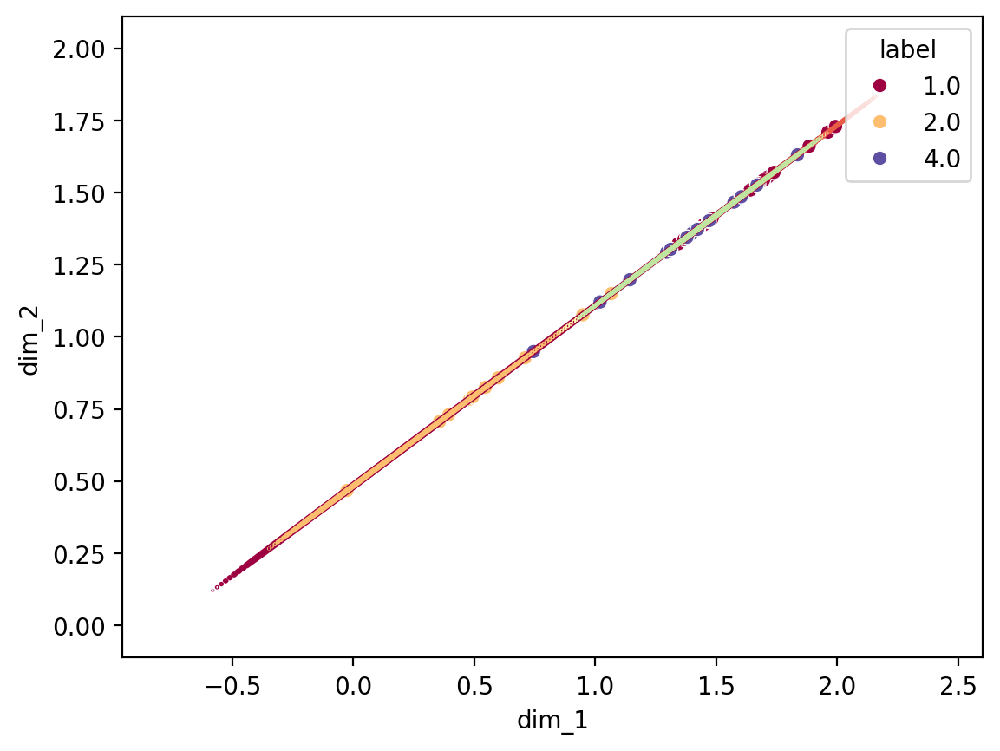

S3


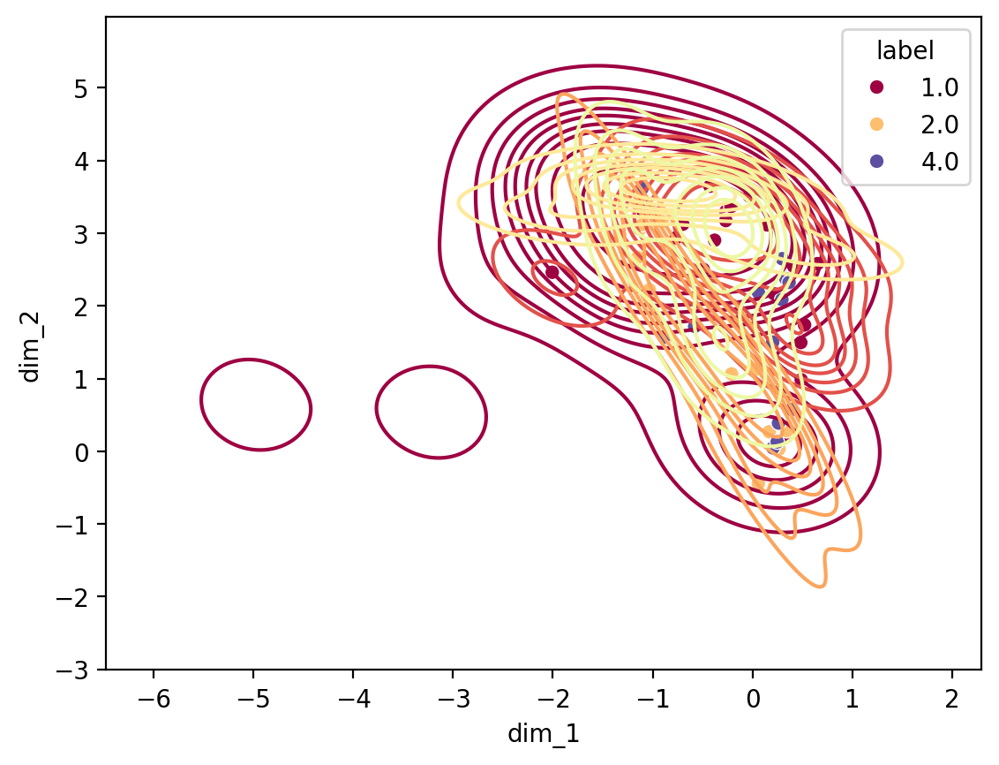

S5


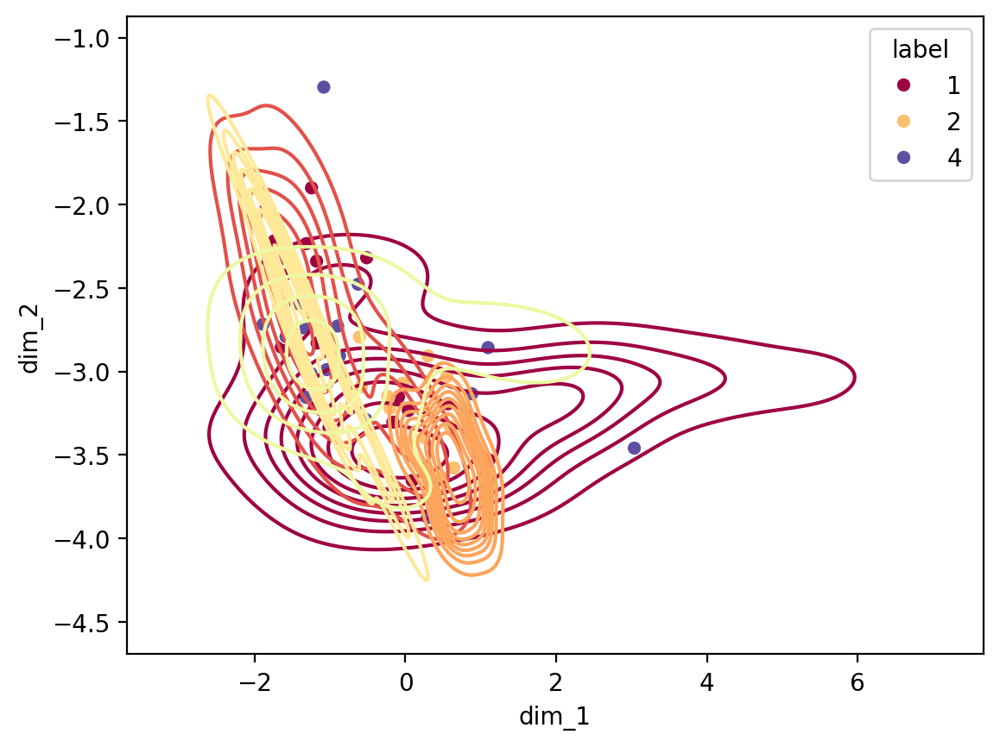

S16


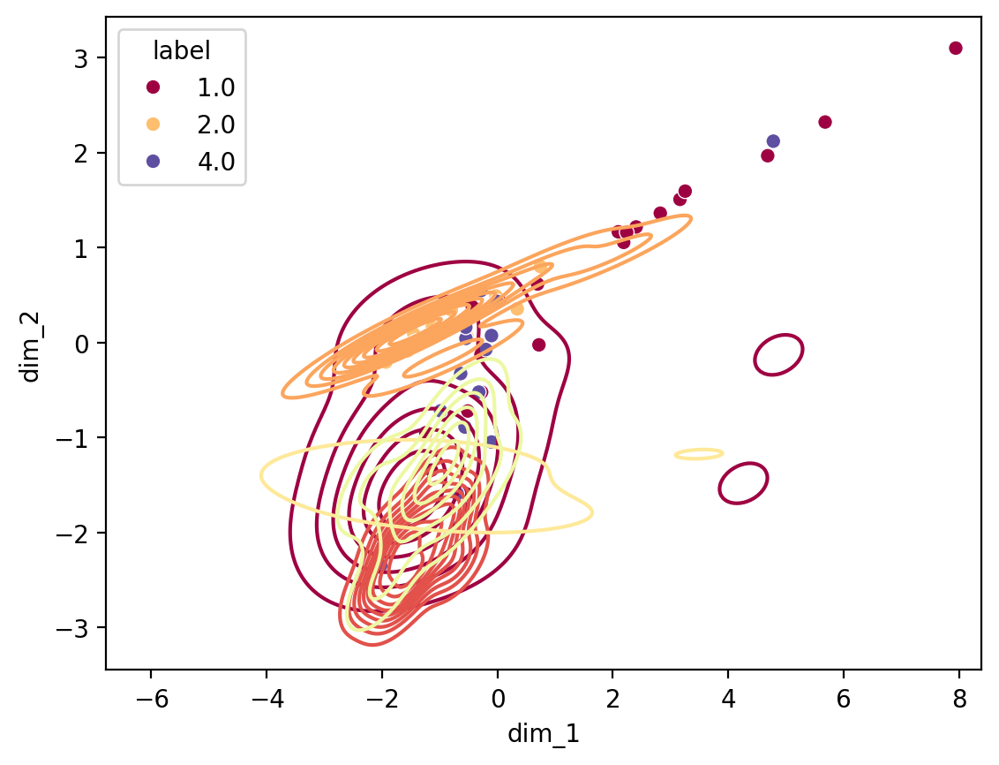

S4


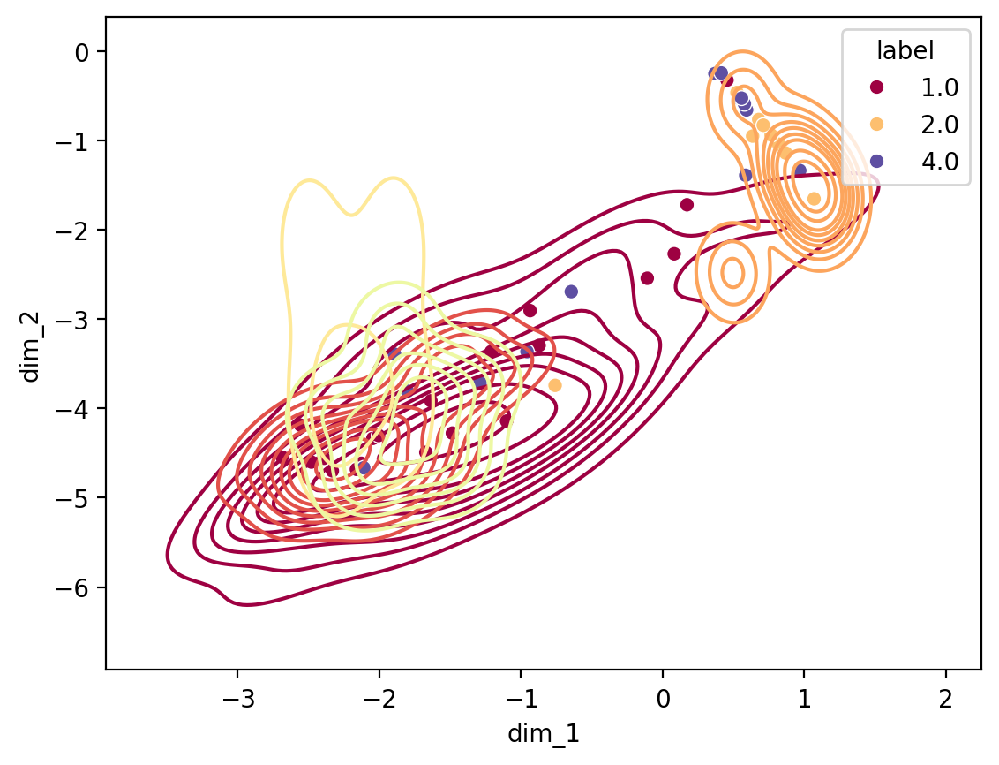

S10


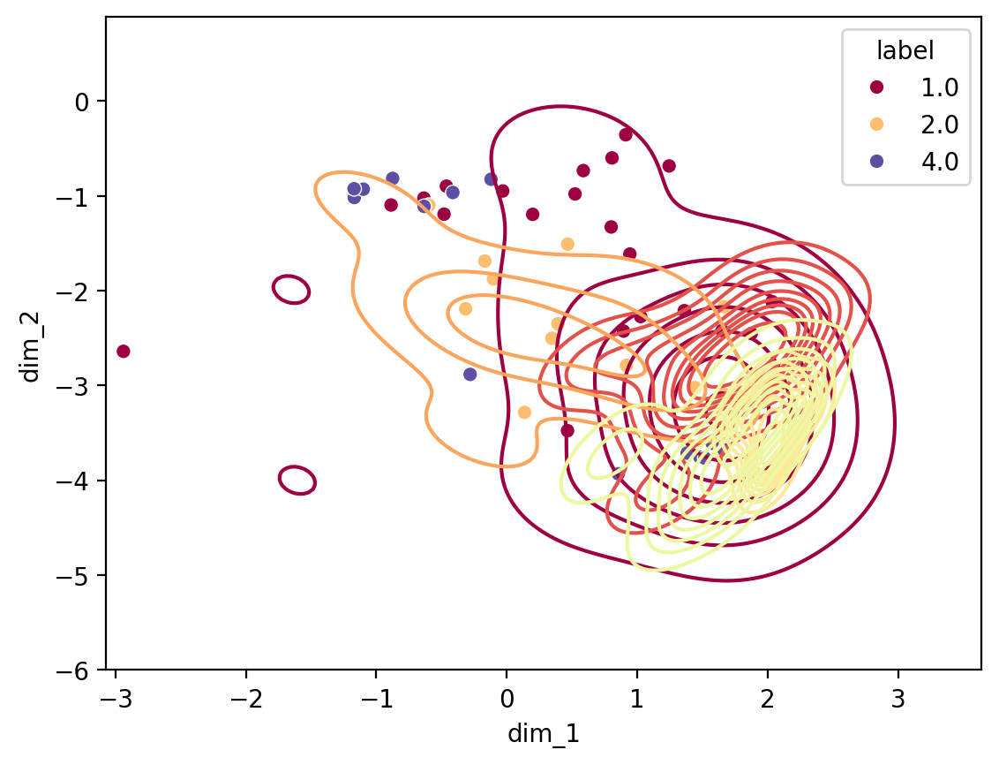

S2


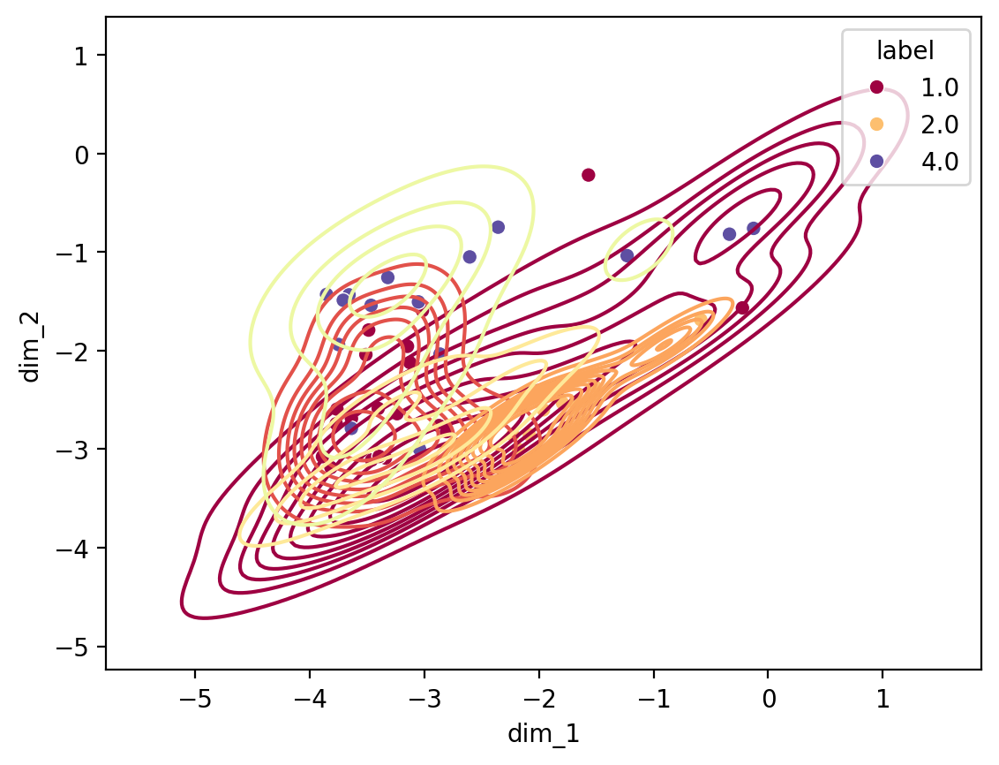

S14


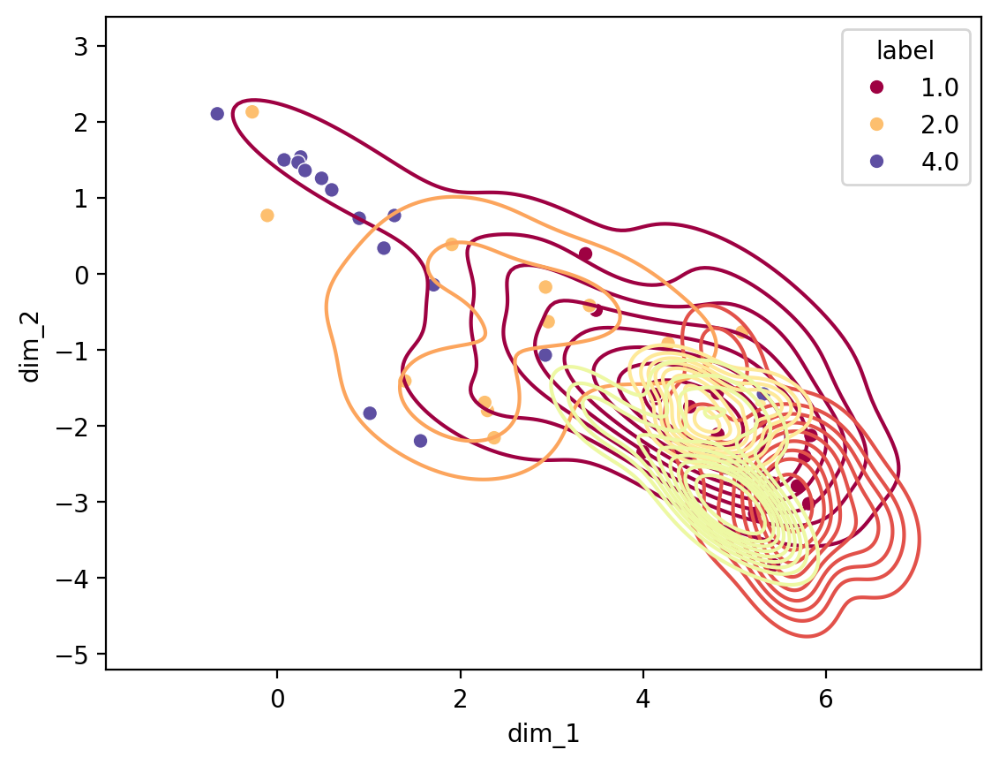

S17


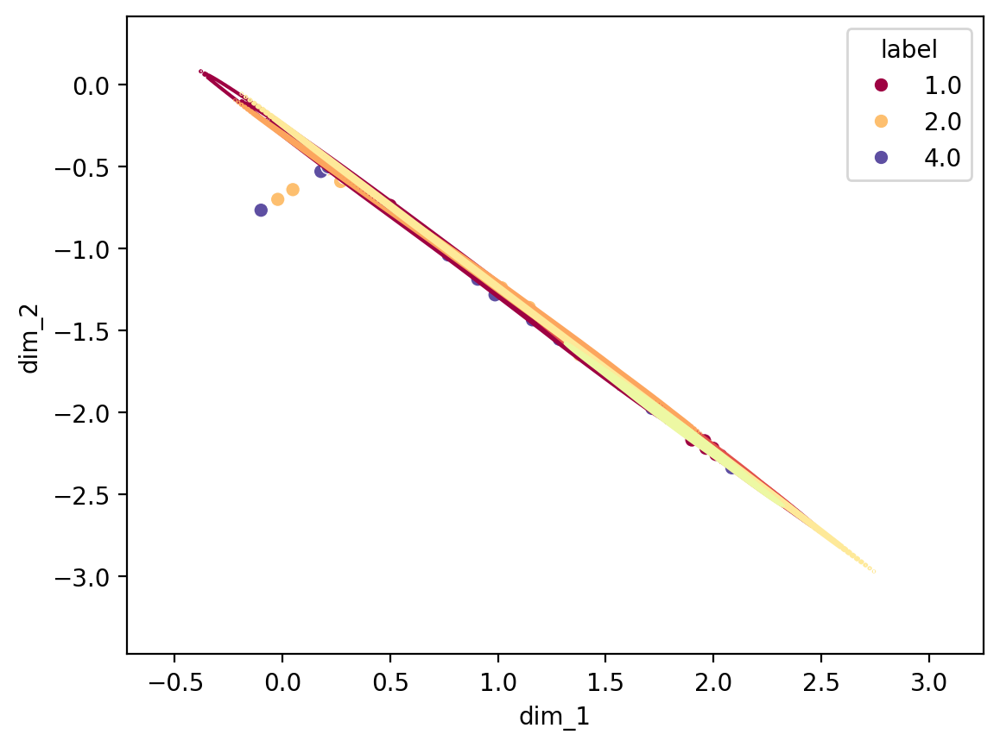

S8


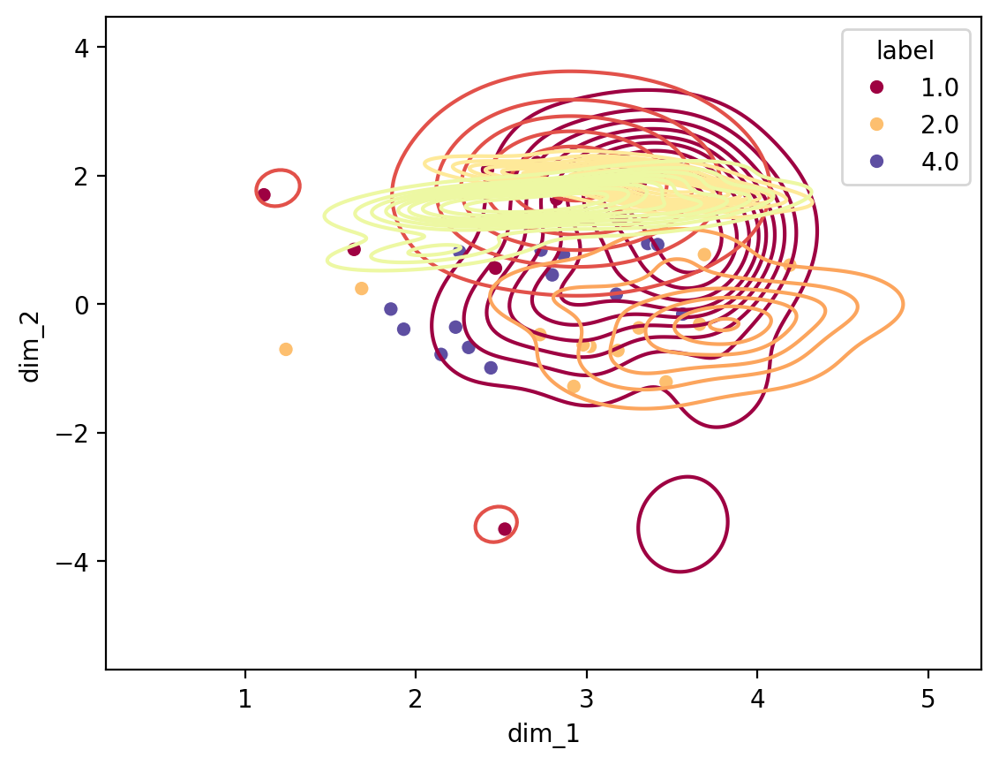

S13


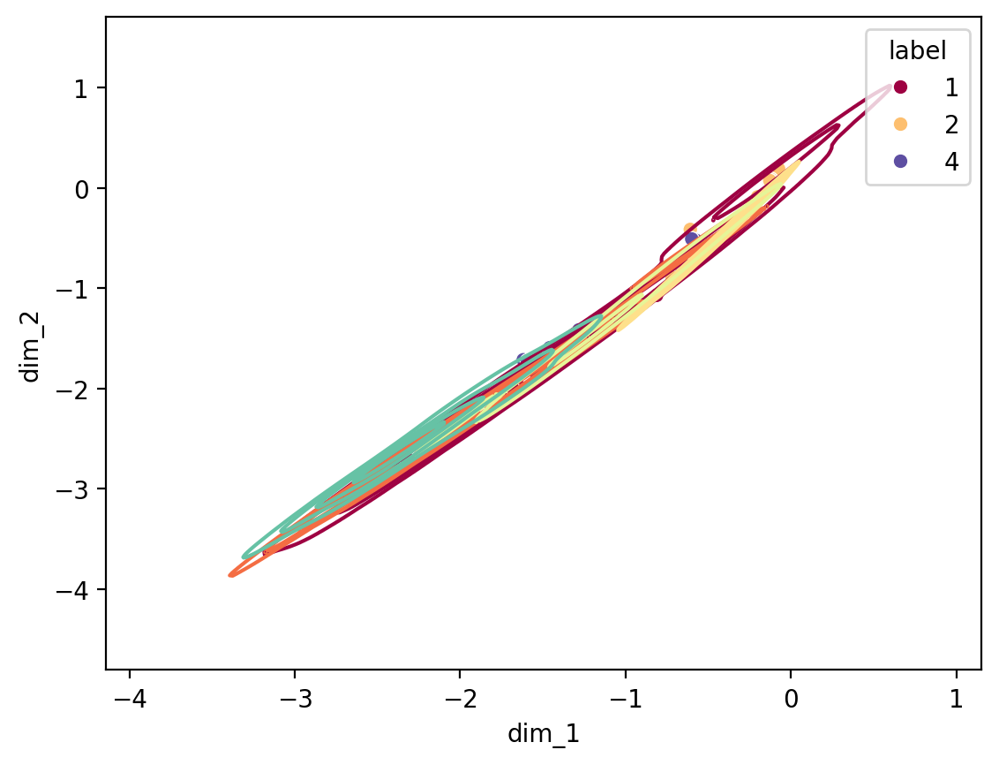

S9


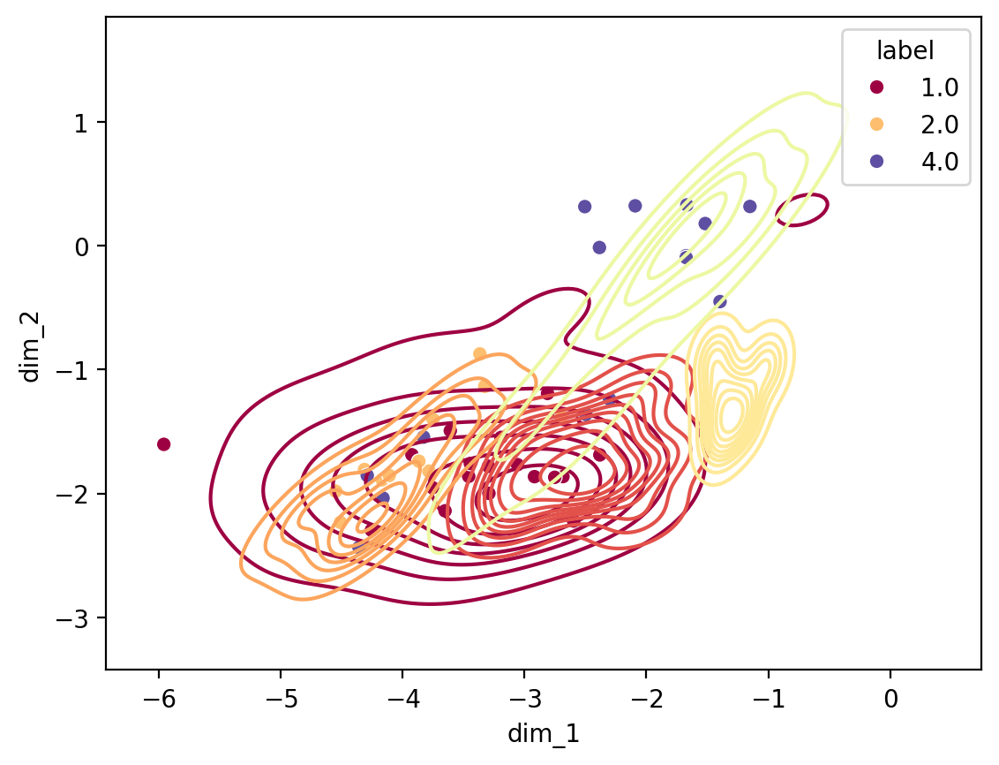

S15


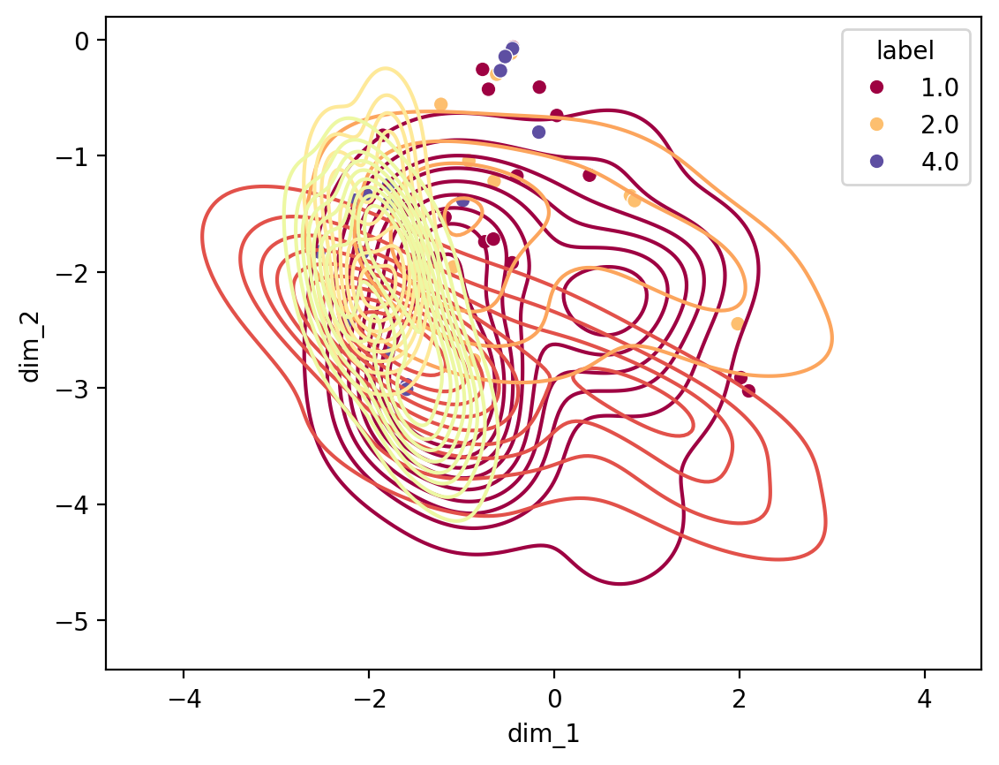

S7


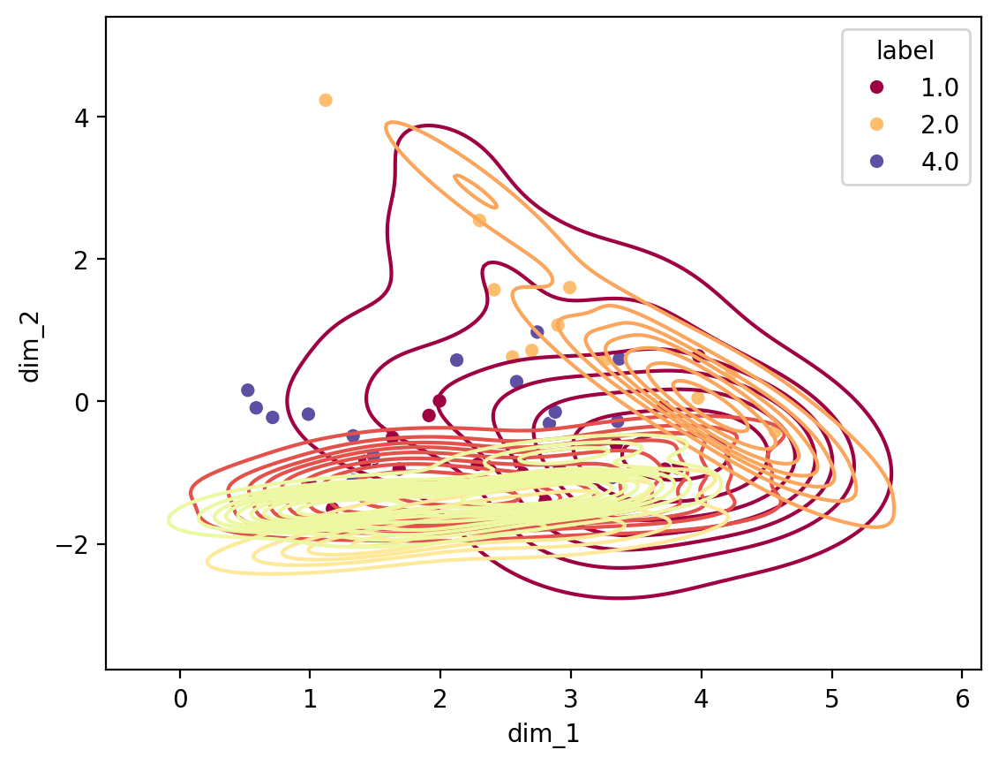

In [458]:
for participant in participants:
    print(participant)
    data = participants_data[participant]['full_data']
    data = clean_data(data)

    y = data['labels'].values
    X = data.loc[:, data.columns != "labels"]
    
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(X)
    scaled_data = torch.from_numpy(scaled_data).type(torch.float)
    
    latent_dims = 2
    n_features = X.shape[1] 
    autoencoder = Autoencoder(n_features, latent_dims).to(device) # GPU
    
    autoencoder = train(autoencoder, scaled_data, epochs=1000)

    test_data = clean_data(participants_data[participant]['processed_data'])
    
    test_y = test_data['labels'].values
    test_x = test_data.loc[:, test_data.columns != "labels"]
    
    test_x_scaled = scaler.transform(test_x)
    test_x_scaled = torch.from_numpy(test_x_scaled).type(torch.float)
    
    z = autoencoder.encoder(scaled_data.to(device))
    z = z.to('cpu').detach().numpy()
    embedding = pd.DataFrame({"dim_1":z[:, 0], "dim_2":z[:, 1], "label":y})
    sns.kdeplot(x="dim_1", y="dim_2", hue="label", data=embedding, palette='Spectral')

    z = autoencoder.encoder(test_x_scaled.to(device))
    z = z.to('cpu').detach().numpy()
    embedding = pd.DataFrame({"dim_1":z[:, 0], "dim_2":z[:, 1], "label":test_y})
    sns.scatterplot(x="dim_1", y="dim_2", hue="label", data=embedding, palette='Spectral')
    plt.show()